# *Simulating the effects of fire on erodibility and sediment transport*
### --- Nishani Moragoda, Laurent Roberge, Kevin Pierce ---

<img src="files/image.jpg">

## Introduction

#### 1. Fire modifies overland flow and cohesion, changing hillslope erodibility and inputting sediment to streams

#### 2. We set out to model this

### Import statements

In [44]:
import os
import time
import imageio
import numpy as np
import matplotlib.pyplot as plt 
from firemodel import *
from create_network import create_network_from_raster
from landlab.io.netcdf import (write_netcdf, read_netcdf)
from landlab import (RasterModelGrid, imshow_grid)
from landlab.plot import graph
from landlab.components import (DepressionFinderAndRouter,
                                FastscapeEroder,
                                FlowAccumulator,
                                Space,
                                ChannelProfiler)
%matplotlib inline

### Set some parameters

In [57]:
# Saving outputs
save=True             # save outputs to a directory or not? 
save_dir = './simul/' # directory in which to save outputs

# Global parameters
dt = 50               # timestep in years
runtime = 100000      # length of the simulation in years

### Instantiate the model grid
This will be a 50x50 node model grid (5000x5000 m). The bottom left corner is open to allow flux out (i.e. the watershed outlet). All other boundary nodes are closed. The initial topography is tilted downwards from the upper right towards the outlet and has random roughness to make it look more natural.

/home/kpierce/anaconda/envs/espin/lib/python3.9/site-packages/landlab/plot/imshow.py:267: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("pink").copy()
  cmap.set_bad(color=color_for_closed)
/home/kpierce/anaconda/envs/espin/lib/python3.9/site-packages/landlab/plot/imshow.py:307: MatplotlibDeprecationWarning: The 'norm' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(norm=norm, shrink=shrink)


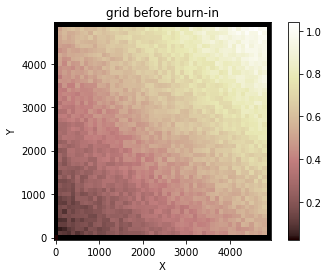

In [58]:
# Some parameters
dx = 100              # distance between each node (m) 
np.random.seed(5000)  # reproducible random seed to add initial topographic roughness
grid_dim = (50,50)    # number of nodes along each axis (x,y)

# Instantiate the raster model grid
mg = RasterModelGrid(grid_dim, xy_spacing=dx)
_ = mg.add_zeros('topographic__elevation', at='node')

# Add tilt and seeded random noise to the topography
mg.at_node['topographic__elevation'] += (mg.node_y / 10000. + 
                                         mg.node_x / 10000. + np.random.rand(len(mg.node_y)) / 10.)

# Set the boundary conditions
mg.set_closed_boundaries_at_grid_edges(bottom_is_closed=True,
                                        left_is_closed=True,
                                        right_is_closed=True,
                                        top_is_closed=True)
mg.set_watershed_boundary_condition_outlet_id(
     0, mg.at_node['topographic__elevation'], -9999.)

# Plot the initial topographic conditions
mg.imshow('node','topographic__elevation')
plt.title('grid before burn-in')
plt.show()

### Instantiate some model components
Fastscape eroder, Flow router, Depression finder

In [59]:
#Instantiate the fastscape eroder, flow router, and depression finder
fr = FlowAccumulator(mg, flow_director='D8')
df = DepressionFinderAndRouter(mg)
fsc = FastscapeEroder(
    mg,
    K_sp=.001,
    m_sp=.5,
    n_sp=1)

### Burn in an initial drainage network
We use the Fastscape eroder to "burn in" (no pun intended...) an initial drainage network. This algorithm is much faster than SPACE, but does not track soil depth (only bedrock elevation). We use it to "fast-forward" to a near steady-state landscape before adding soil to set up the conditions for the SPACE model.

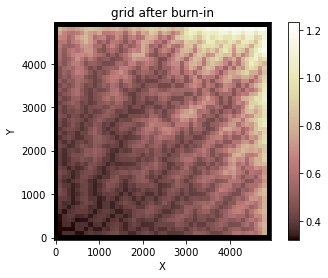

In [60]:
# Time loop running the fastscape eroder
for it in range(100):
    fr.run_one_step()
    df.map_depressions()
    fsc.run_one_step(dt=dt)
    mg.at_node['topographic__elevation'][0] -= 0.002 # Uplift

# save fastcape landscape for later. 
mgfs = mg
    
# Add soil to the drainage network (for SPACE)
_ = mg.add_zeros('soil__depth', at='node', dtype=float) 
mg.at_node['soil__depth'] += 0.5
mg.at_node['topographic__elevation'] += mg.at_node['soil__depth']

# Plot the burned in topographic conditions
mg.imshow('node','topographic__elevation')
plt.title('grid after burn-in')
plt.show()

### Instantiate some more model components
SPACE, Erodibility stepper, Burner

In [31]:
# Instantiate the SPACE component
K_sed0 = 0.00005 # the baseline soil erodiblity
K_sed = np.ones(mg.shape)*K_sed0 # the initial soil erodibility per node
ha = Space(
    mg,
    K_sed=K_sed,
    K_br=1e-10,
    F_f=0.5,
    phi=0.1,
    H_star=1.,
    v_s=0.001,
    m_sp=0.5,
    n_sp = 1.0,
    sp_crit_sed=0,
    sp_crit_br=0)

# Instantiate the erodibility stepper
decay_time = dt*3 # time it takes the erodibility perturbution to decay
es = ErodibilityStepper(decay_time=decay_time, K_sed0=K_sed0)

# Instantiate the burner
R_fire_mean = grid_dim[0]/10*dx
fire_freq = 1/(7*dt)
K_sed_boost = 20*K_sed0
burner = Burner(fire_freq=fire_freq,
                R_fire_mean=R_fire_mean,
                K_sed_boost=K_sed_boost,
                dt=dt)

### Run the landscape evolution model

In [32]:
start_time = time.time()

for it in range(runtime//dt):
    fr.run_one_step()           # accumulate the flow
    df.map_depressions()        # find landscape depressions (which do not erode)
    ha.run_one_step(dt=dt)      # step the transport model
    es.stepper(ha,dt=dt)        # decay the erodibility back to baseline from the former timestep
    burner.fire(ha,mg)          # light any fires (increase erodibility)
    mg.at_node['bedrock__elevation'][0] -= 3e-6*dt # add in the uplift
    if it*dt % 1000 == 0:
        print("--", it*dt, "years -- %s seconds --" % round((time.time() - start_time), 1))
    if (it*dt % 100 == 0) & save: # save every 100 years
        filename = save_dir + 'simul_%05d.nc'%it
        filename_npy = save_dir + 'simul_%05d'%it
        #mg.(filename, names='topographic__elevation')
        write_netcdf(filename, mg, format="NETCDF3_64BIT", names=["topographic__elevation","sediment__flux"])
        np.save(filename_npy, K_sed)

fire at (3500.0,1900.0) with 45 nodes inflamed
-- 0 years -- 0.3 seconds --
fire at (4300.0,4500.0) with 57 nodes inflamed
-- 1000 years -- 6.2 seconds --
fire at (400.0,4400.0) with 9 nodes inflamed
-- 2000 years -- 12.0 seconds --
fire at (3600.0,1300.0) with 1 nodes inflamed
fire at (500.0,1600.0) with 1 nodes inflamed
fire at (2600.0,4700.0) with 9 nodes inflamed
fire at (4000.0,2200.0) with 101 nodes inflamed
fire at (2100.0,3100.0) with 5 nodes inflamed
-- 3000 years -- 17.8 seconds --
fire at (0.0,300.0) with 1 nodes inflamed
fire at (400.0,4500.0) with 21 nodes inflamed
fire at (4700.0,2200.0) with 49 nodes inflamed
fire at (3000.0,4400.0) with 61 nodes inflamed
-- 4000 years -- 23.6 seconds --
fire at (2800.0,4900.0) with 212 nodes inflamed
fire at (600.0,2700.0) with 1 nodes inflamed
-- 5000 years -- 29.3 seconds --
fire at (4200.0,3500.0) with 434 nodes inflamed
fire at (300.0,3200.0) with 346 nodes inflamed
fire at (4700.0,1000.0) with 1 nodes inflamed
fire at (3200.0,2600.

fire at (3900.0,1100.0) with 502 nodes inflamed
fire at (1000.0,3200.0) with 233 nodes inflamed
fire at (4900.0,3300.0) with 351 nodes inflamed
fire at (2500.0,4800.0) with 9 nodes inflamed
fire at (4300.0,4300.0) with 205 nodes inflamed
fire at (4700.0,2800.0) with 352 nodes inflamed
-- 55000 years -- 315.1 seconds --
fire at (2200.0,1000.0) with 672 nodes inflamed
fire at (4000.0,2100.0) with 9 nodes inflamed
fire at (3100.0,3400.0) with 137 nodes inflamed
fire at (1500.0,2900.0) with 9 nodes inflamed
-- 56000 years -- 320.7 seconds --
fire at (4400.0,800.0) with 89 nodes inflamed
-- 57000 years -- 326.3 seconds --
fire at (3200.0,3400.0) with 21 nodes inflamed
fire at (2300.0,4200.0) with 727 nodes inflamed
-- 58000 years -- 331.9 seconds --
fire at (1300.0,4100.0) with 394 nodes inflamed
fire at (1900.0,1600.0) with 137 nodes inflamed
-- 59000 years -- 337.5 seconds --
fire at (300.0,1100.0) with 1 nodes inflamed
-- 60000 years -- 343.1 seconds --
fire at (1100.0,1300.0) with 149 n

### Visualizations

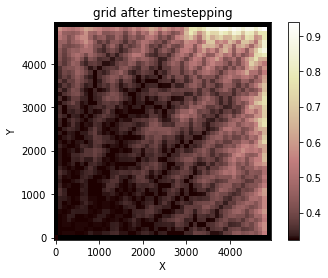

In [33]:
# Topography after evolving the landscape
mg.imshow('node','topographic__elevation')
plt.title('grid after timestepping')
plt.show()

/home/kpierce/anaconda/envs/espin/lib/python3.9/site-packages/landlab/plot/imshow.py:267: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("Blues").copy()
  cmap.set_bad(color=color_for_closed)


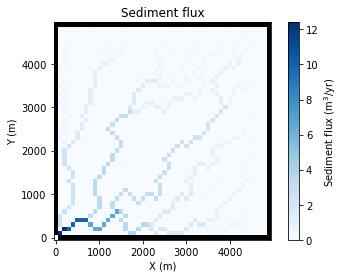

In [34]:
# Map of sediment flux
fig = plt.figure()
plot = plt.subplot()
imshow_grid(mg, 'sediment__flux', plot_name='Sediment flux', var_name = 'Sediment flux', var_units=r'm$^3$/yr', grid_units=('m', 'm'), cmap='Blues')
plt.show()

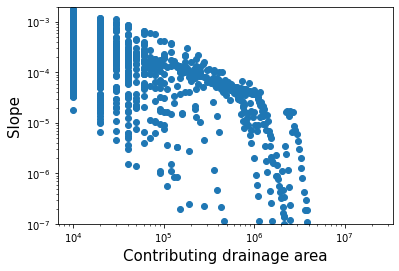

In [36]:
# Slope-area plot
area = mg.at_node['drainage_area'][mg.core_nodes]
slope = mg.at_node['topographic__steepest_slope'][mg.core_nodes]

fig = plt.figure()
slope_area_plot = plt.subplot()
slope_area_plot.set_xscale('log')
slope_area_plot.set_yscale('log')
plt.scatter(area, slope)
plt.xlabel('Contributing drainage area',fontsize=15)
plt.ylabel('Slope',fontsize=15)
plt.ylim(1e-7,2e-3)
plt.show()

### Output a NetworkModelGrid

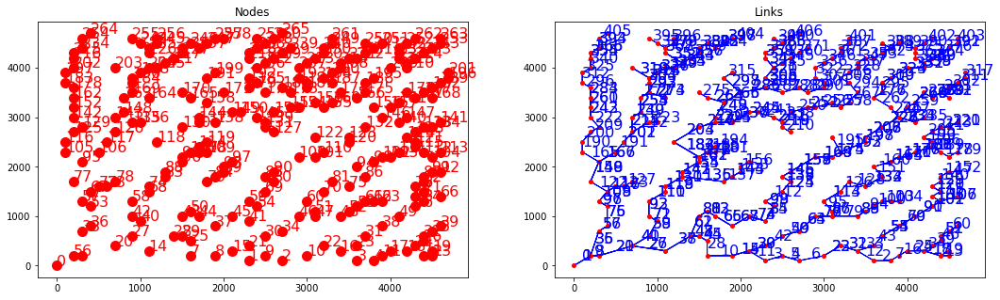

In [37]:
nmg = create_network_from_raster(
    mg,
    method='variable', # method
    n_widths=dx,
    #node_spacing=30,
    #d_node_spacing=2*dx,
    min_channel_thresh=30000,
    fields=['drainage_area', 'topographic__elevation'])

## Plot nodes
plt.figure(figsize=(18,5))
plt.subplot(1,2,1)
graph.plot_nodes(nmg)
plt.title("Nodes")

## Plot nodes + links
plt.subplot(1,2,2)
graph.plot_nodes(nmg,with_id=False,markersize=4)
graph.plot_links(nmg)
plt.title("Links")
plt.show()

### Define a plotting function

In [38]:
def plotter(grid,K_sed):
    pinks = plt.get_cmap('pink') # pink colormap
    greys = plt.get_cmap('gist_gray')#plt.get_cmap('gist_gray') # grey colormap
    def cm_black(arr):
        return np.array([0,0,0,0.5]).astype('float')*np.ones_like(arr)[:,np.newaxis]
    #greys = cm_black
    # set up a blank image... 
    im = np.zeros(shape=(grid_dim[0],grid_dim[1],4))

    # get the elevations from the grid
    z = mg.at_node['topographic__elevation']
    zs = (z-z.min())/(z.max()-z.min())
    # determine "burned" locations in the image
    tol = K_sed0*1.5 # tolerance for "burned"
    mask = (K_sed > tol).flatten() # mask of places "burned"

    # get colors for burned locations
    #a = 0.9 #
    a = ((((K_sed-K_sed0)/K_sed_boost)).flatten())[mask][:,np.newaxis]
    a = (a+1)/2
    bvals = greys(zs[mask])*a + pinks(zs[mask])*(1-a)

    # get colors for not burned locations
    vals = pinks(zs[~mask])

    # fill in values within the image..
    smask = np.stack((mask.reshape(grid_dim[0],grid_dim[1]),)*4,-1)
    im[smask] = bvals.flatten()
    im[~smask] = vals.flatten()

    # fill in all edge nodes..
    def edge_mask(x):
        # https://stackoverflow.com/questions/48097068/how-to-get-boundaries-of-an-numpy-array
        mask = np.ones(x.shape, dtype=bool)
        mask[x.ndim * (slice(1, -1),)] = False
        return mask
    edge = edge_mask(im[:,:,0])
    im[edge]=np.array([0,0,0,1])
    
    # plot the image..
    x = np.linspace(0,dx*grid_dim[0],dx)
    y = np.linspace(0,dx*grid_dim[1],dx)
    #x,y = np.meshgrid(x,y)
    plt.imshow(im,extent=[x.min(),x.max(),y.min(),y.max()],origin='lower')
    
    graph.plot_links(nmg,with_id=False)

### Plot showing burned areas

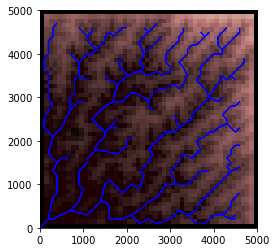

In [39]:
plotter(mg,K_sed)

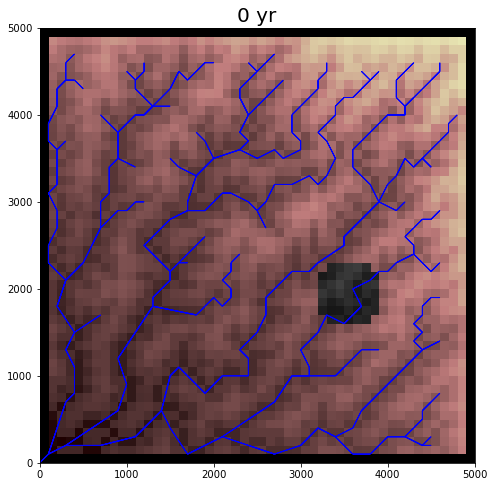

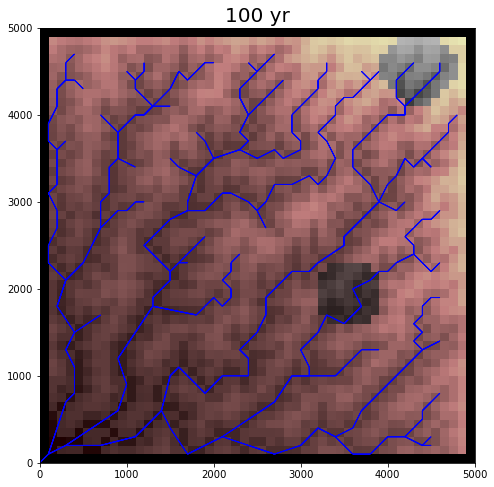

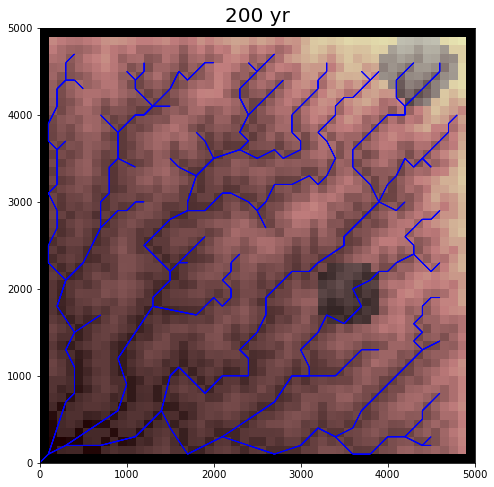

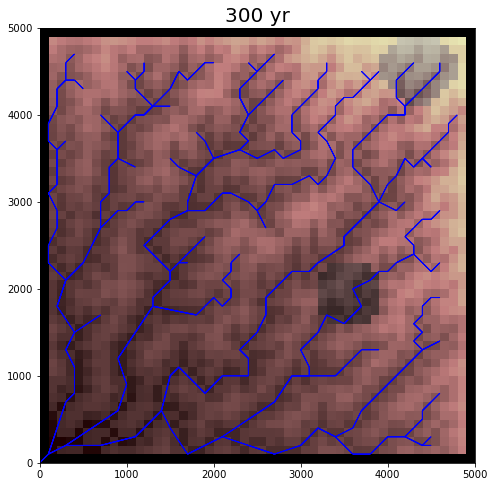

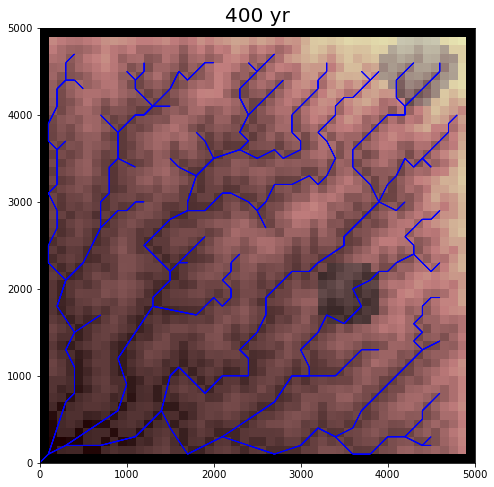

...

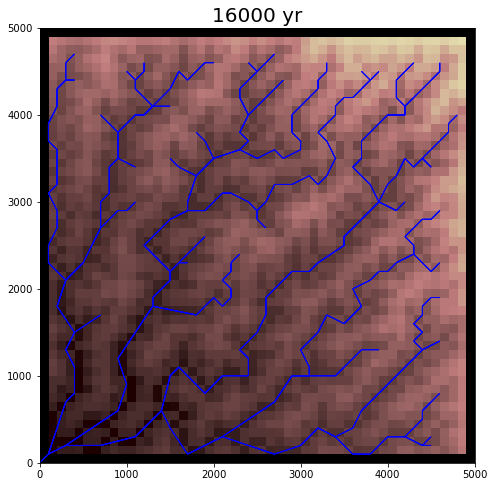

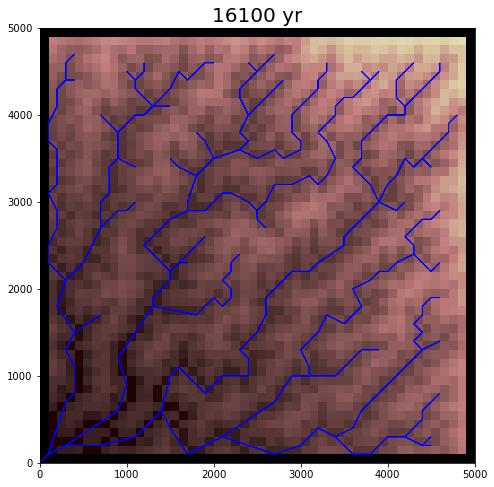

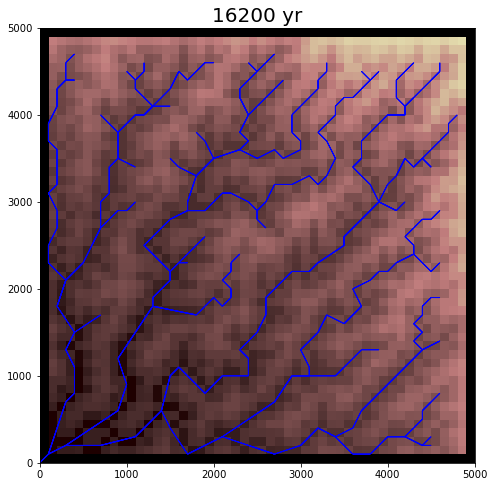

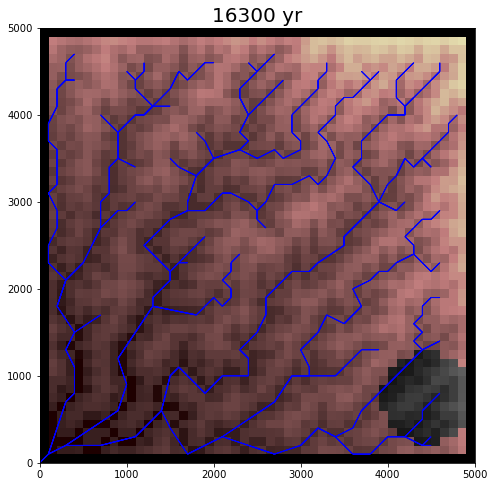

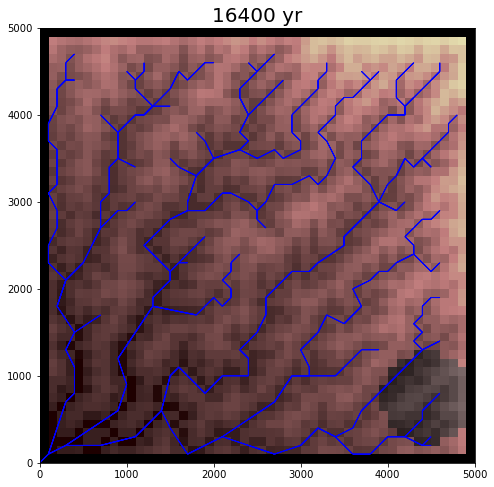

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


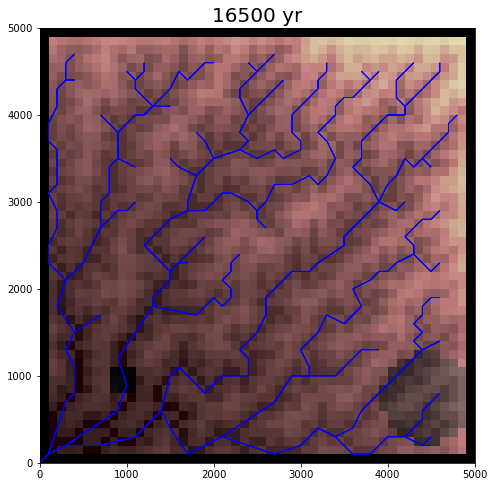

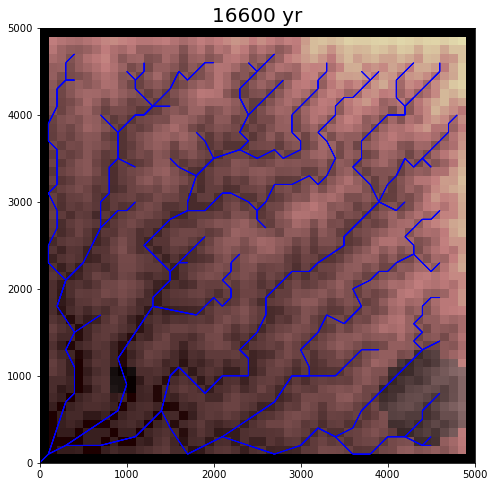

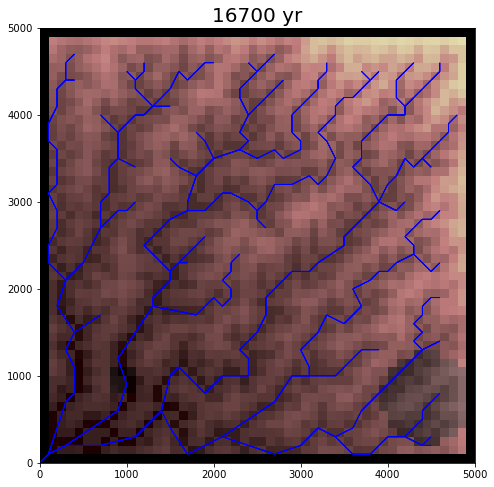

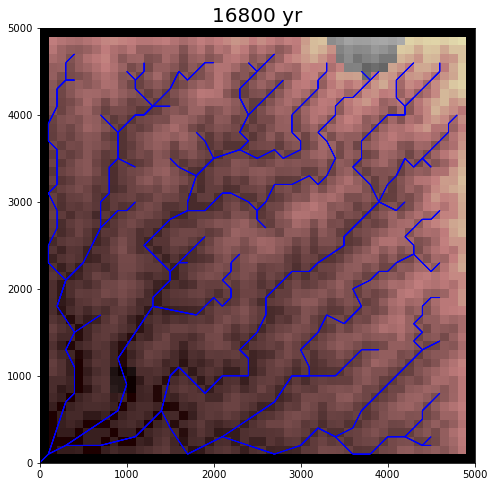

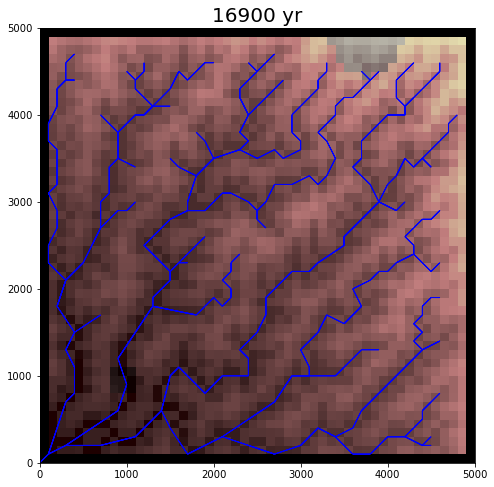

...

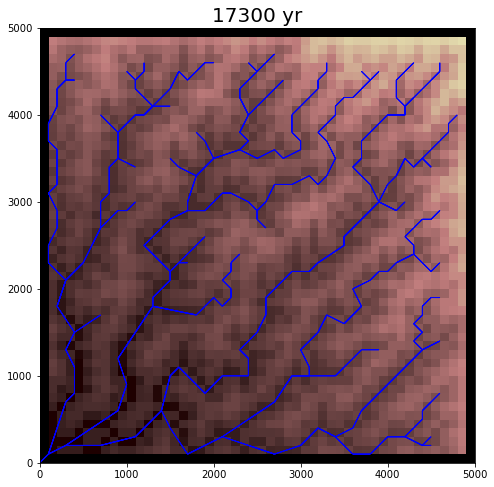

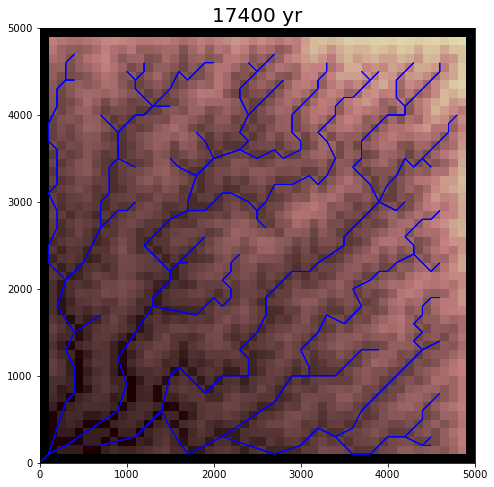

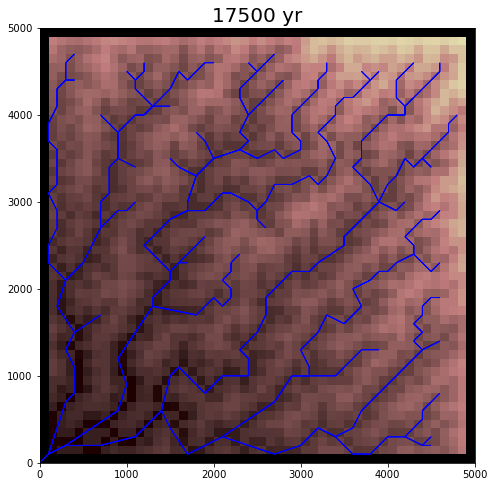

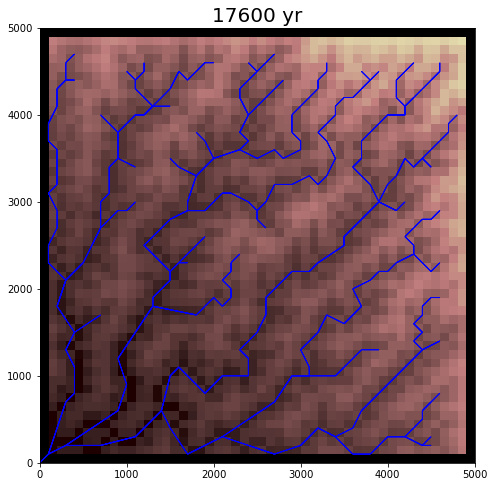

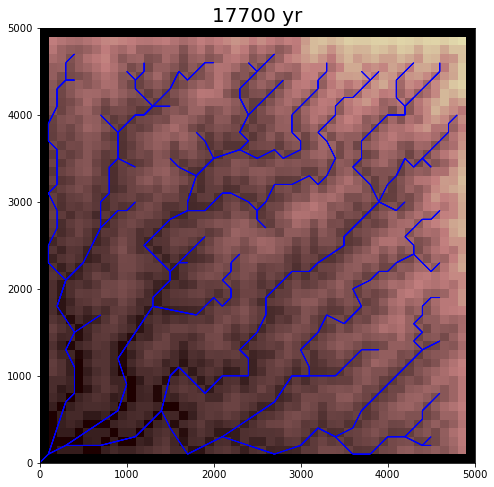

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


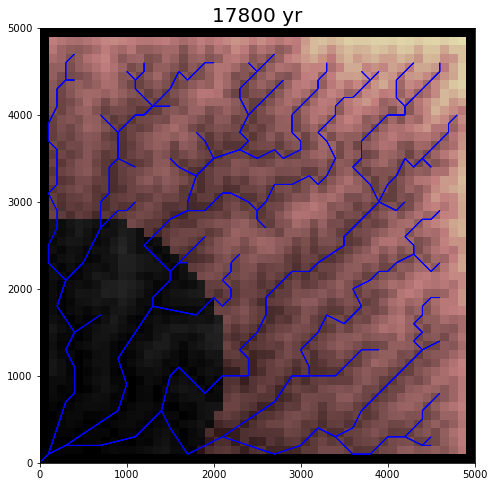

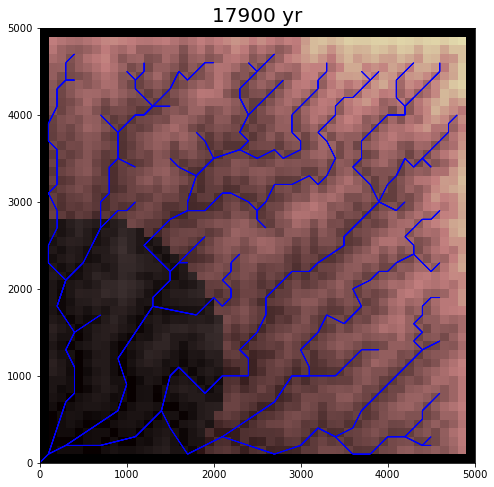

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


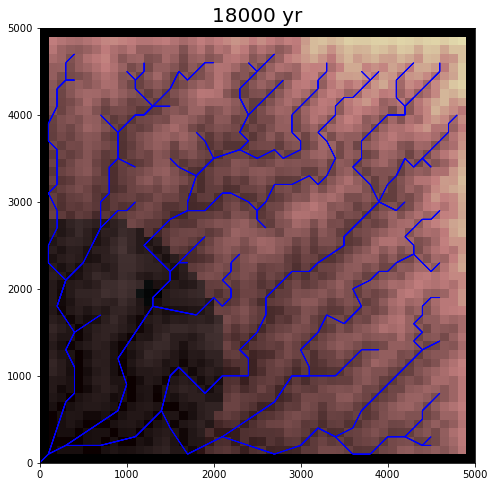

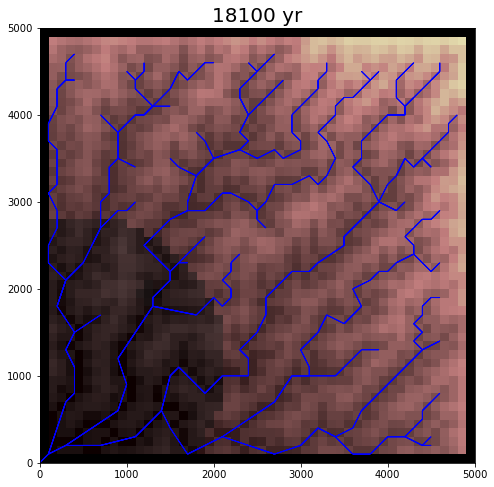

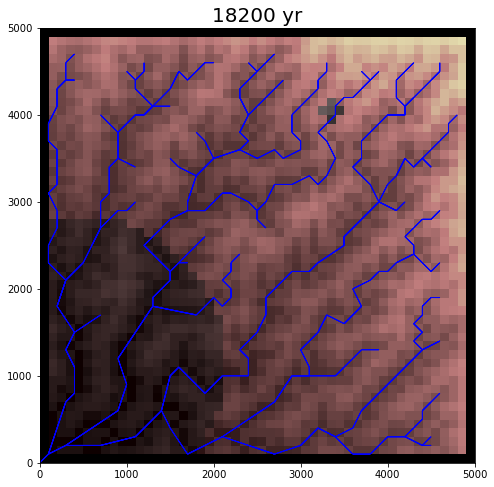

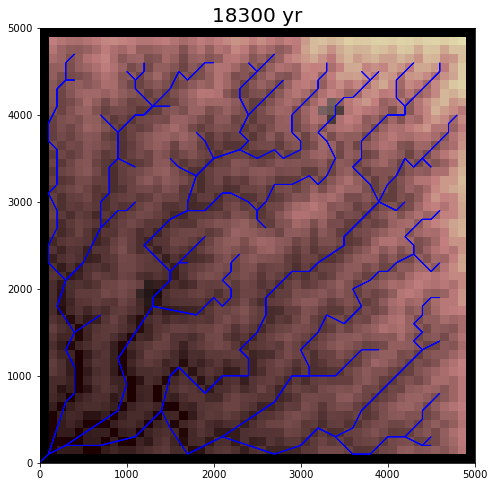

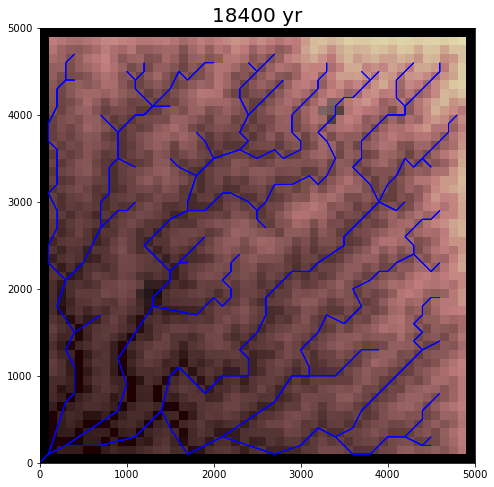

...

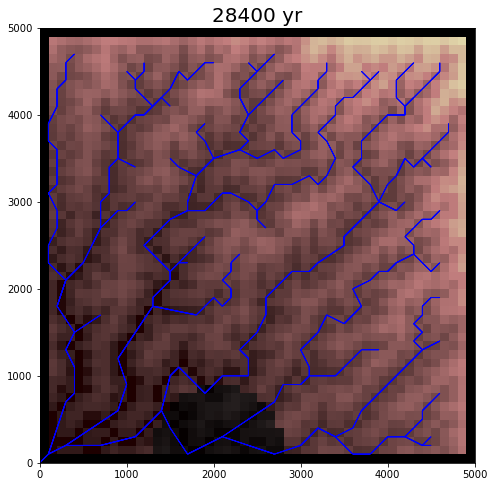

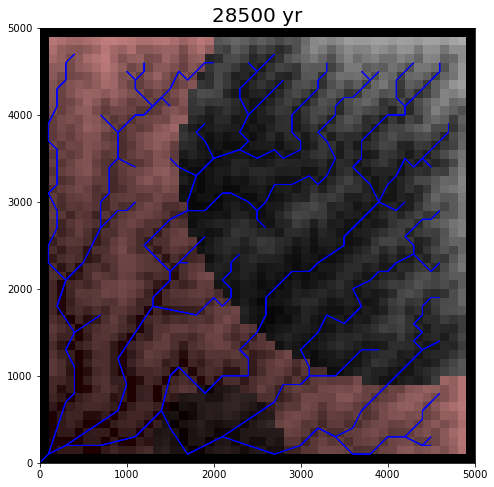

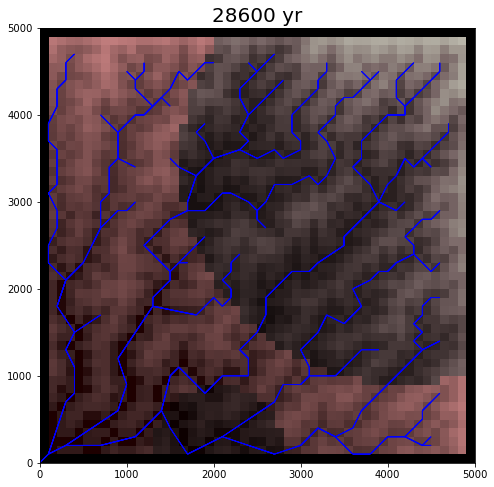

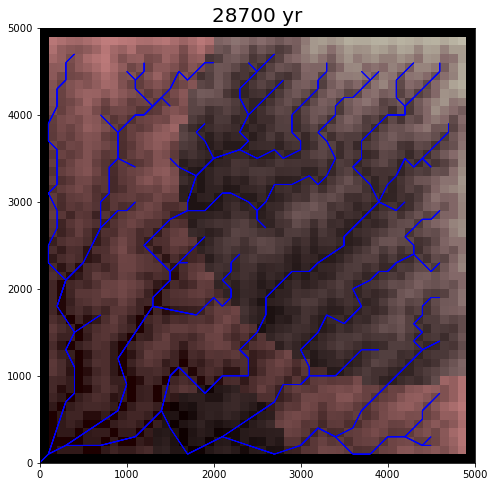

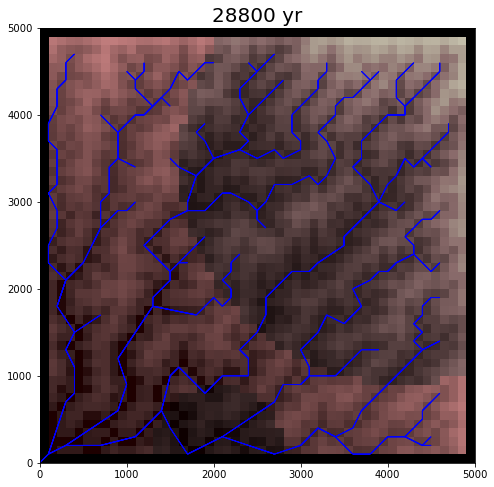

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


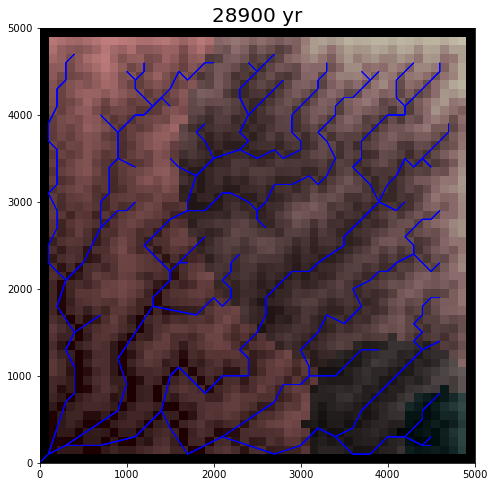

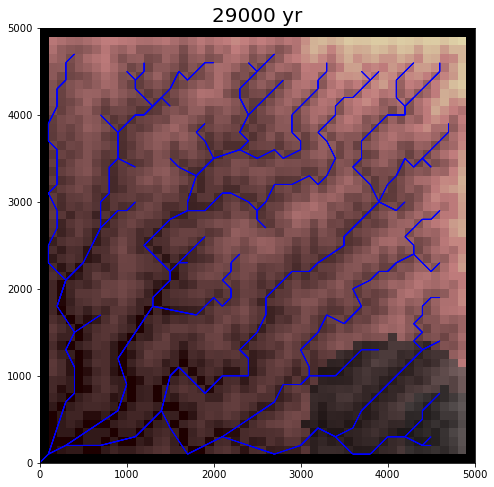

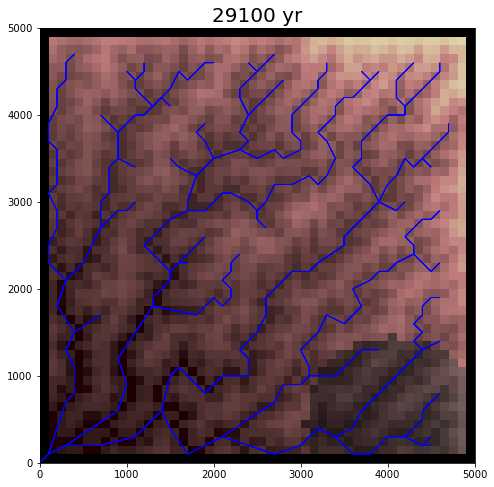

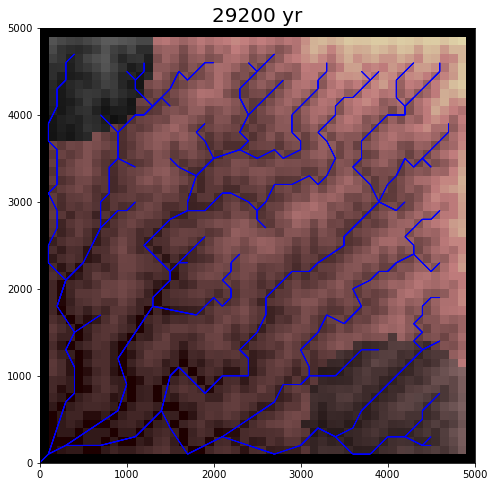

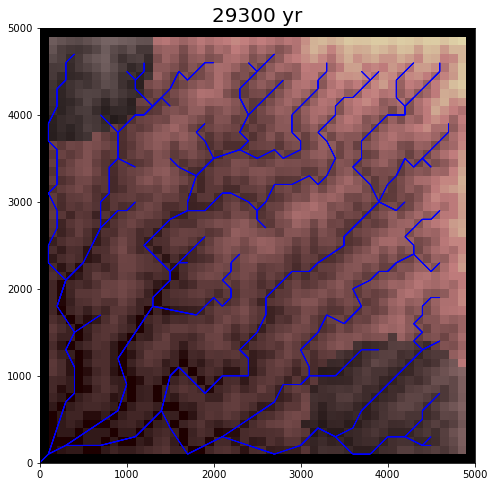

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


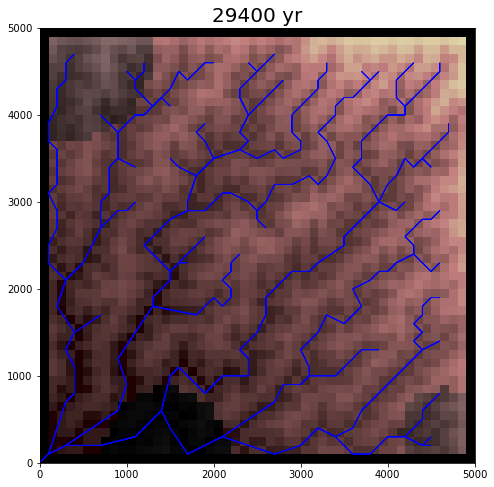

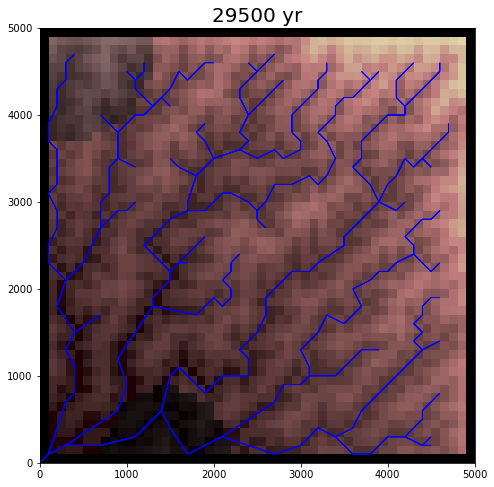

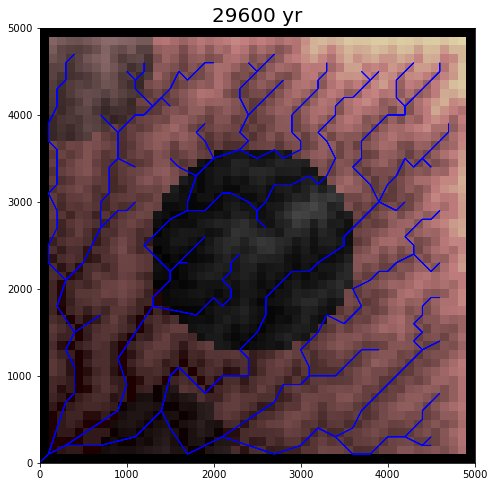

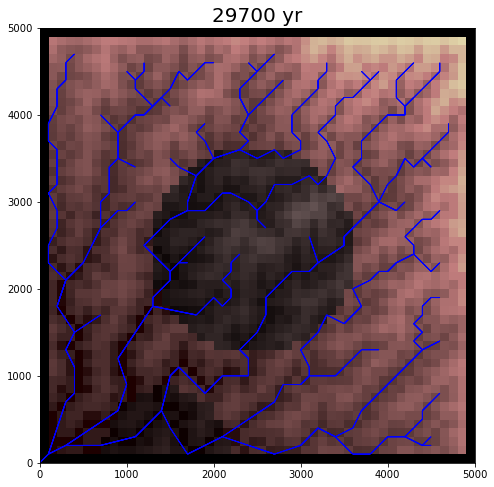

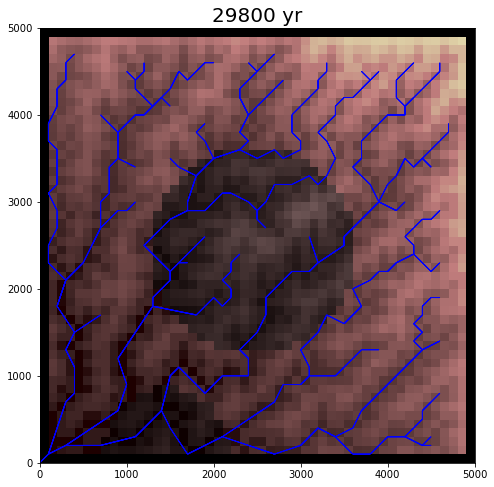

...

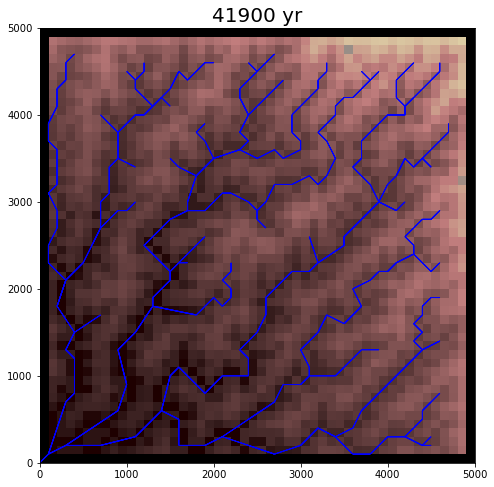

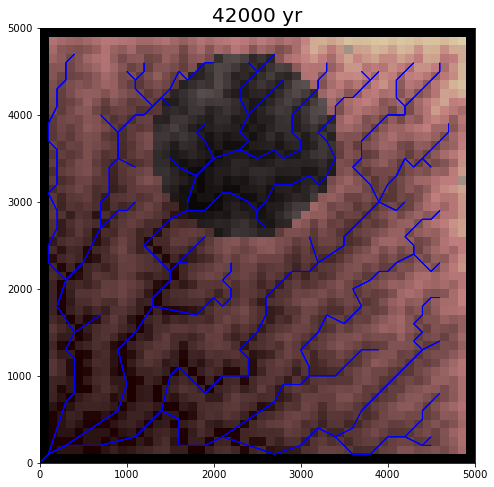

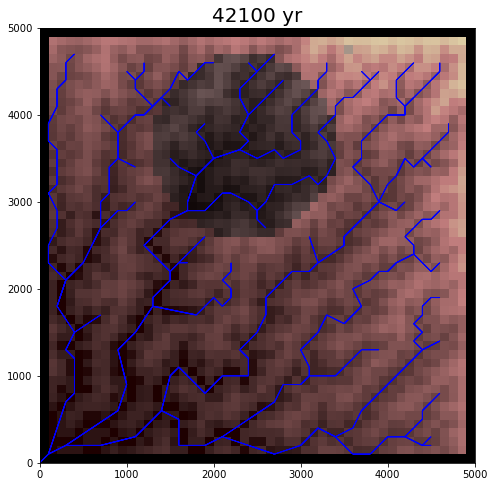

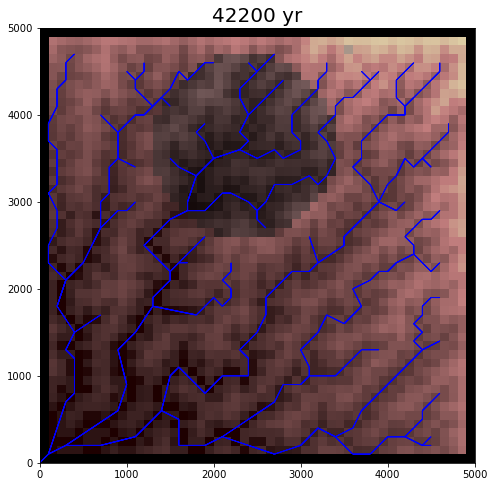

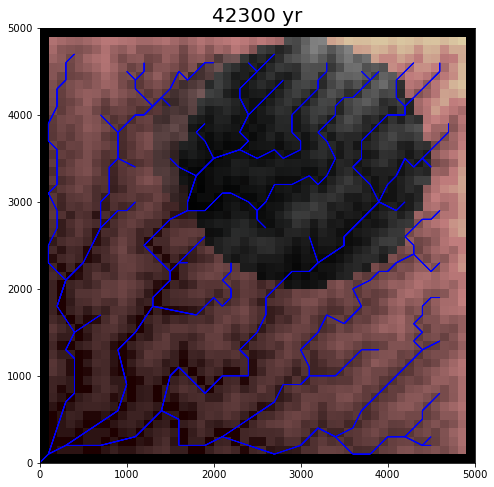

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


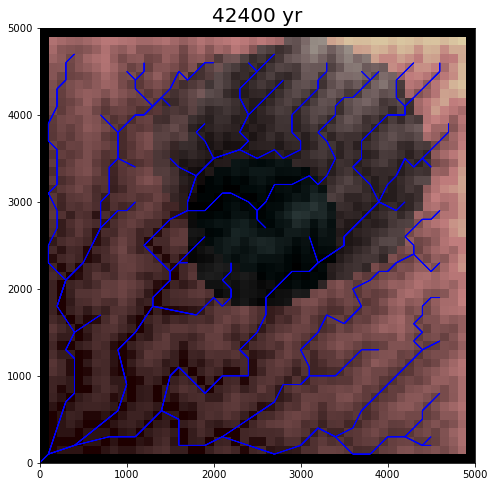

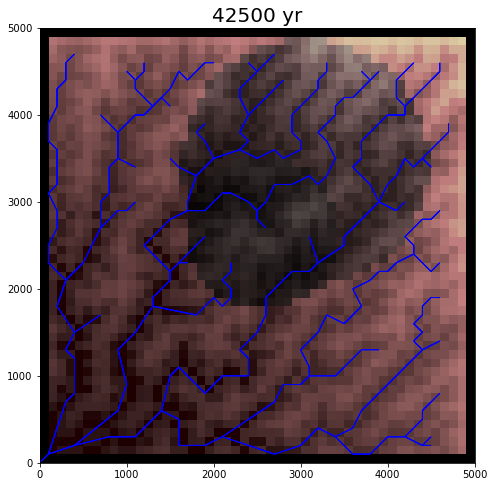

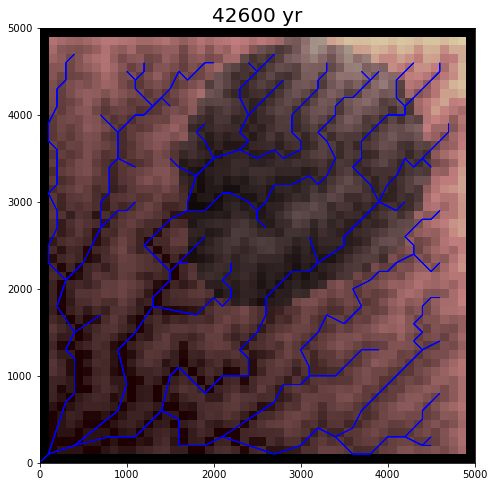

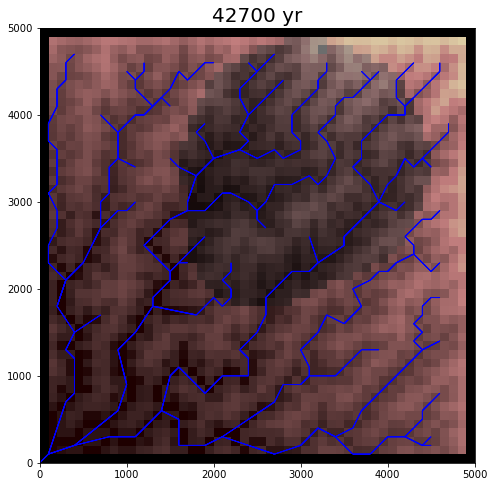

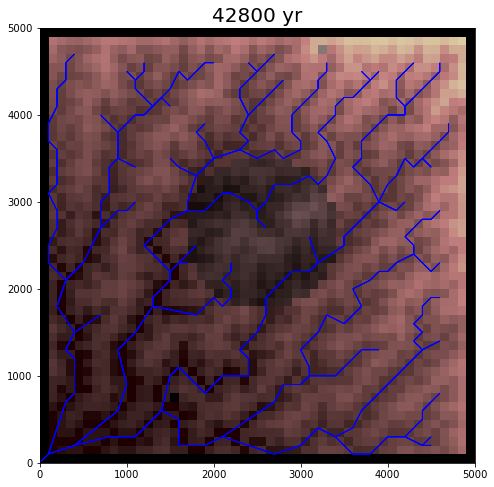

...

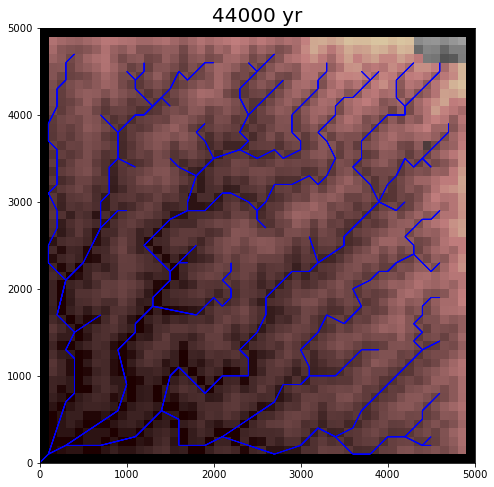

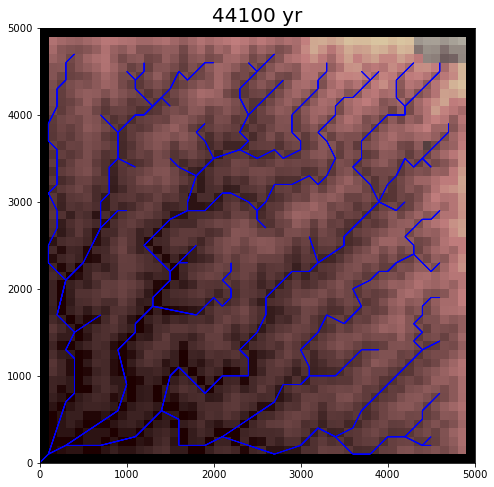

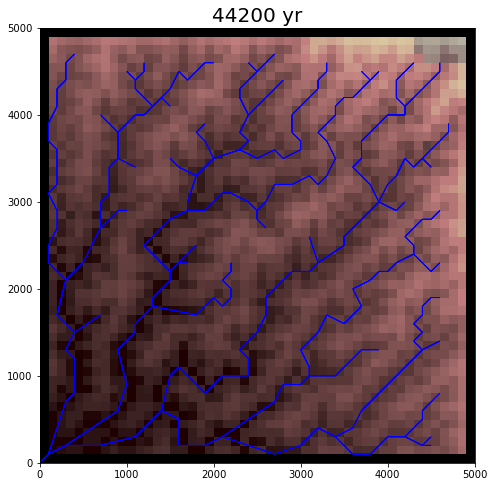

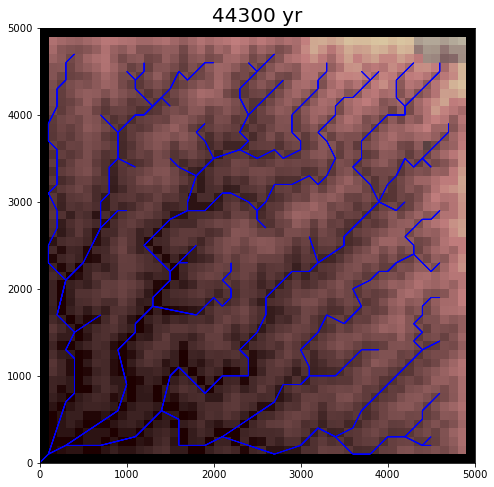

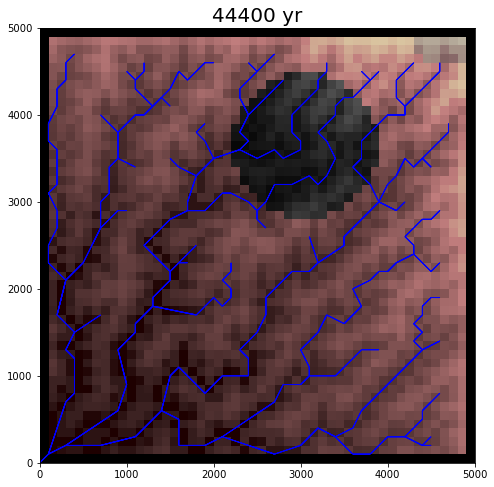

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


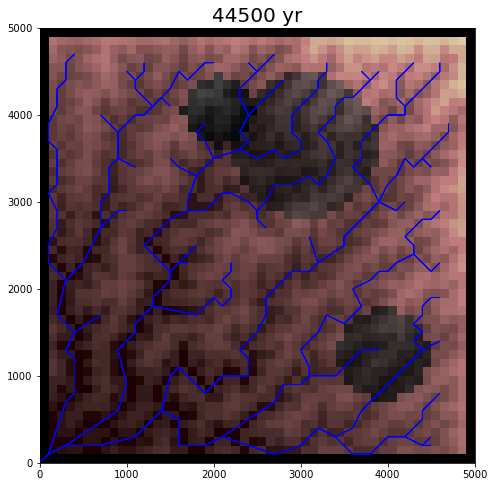

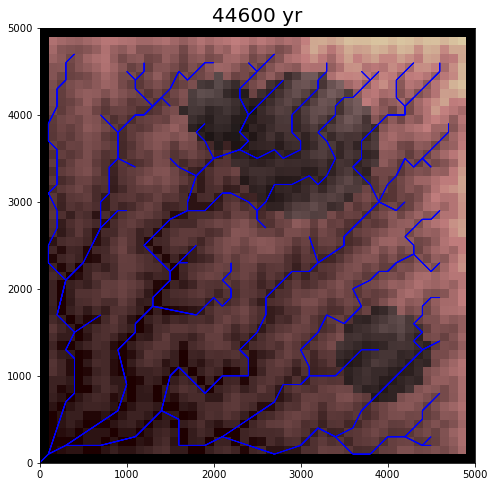

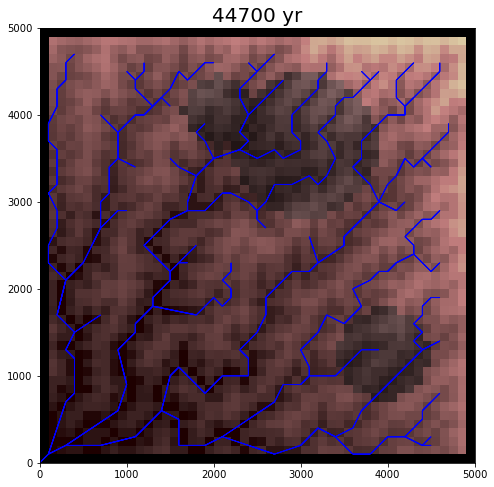

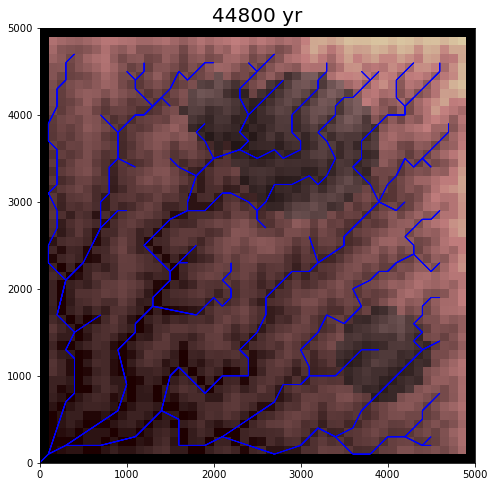

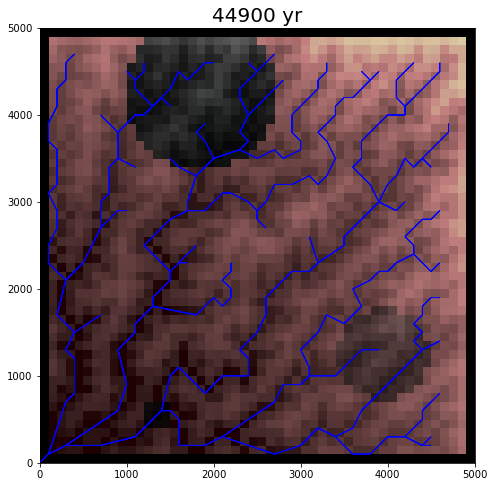

...

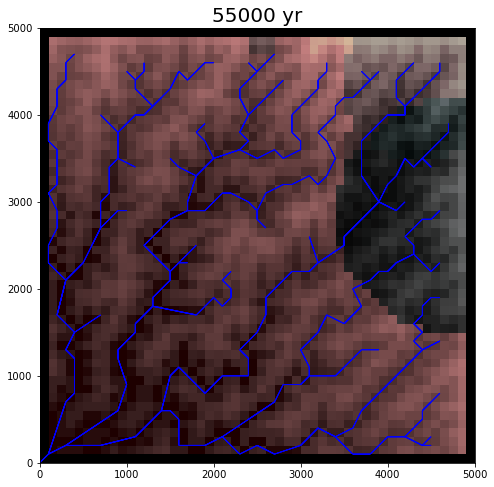

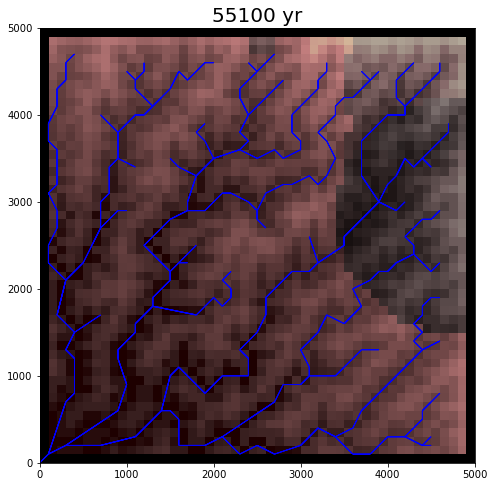

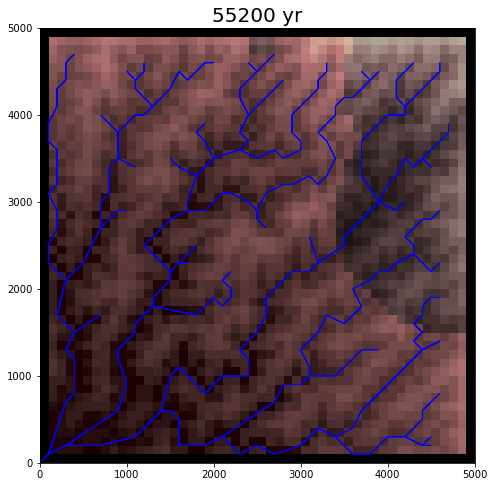

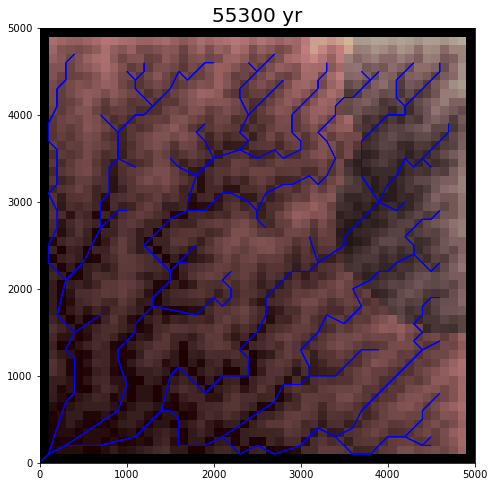

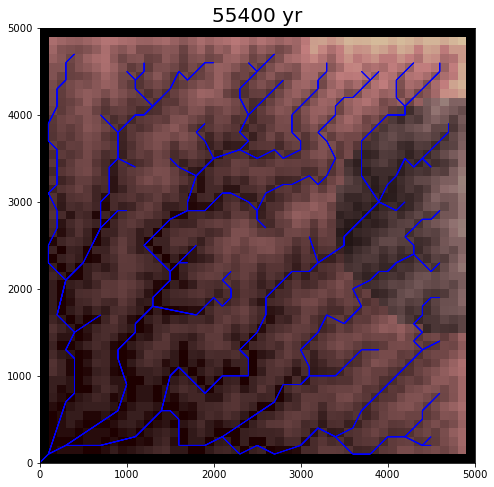

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


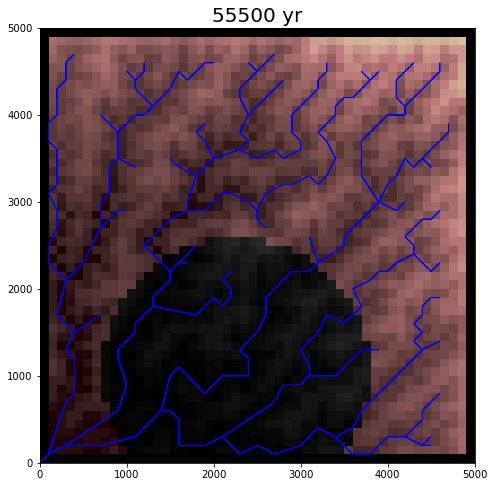

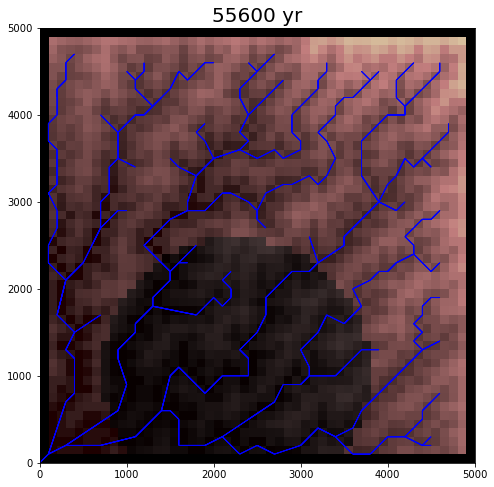

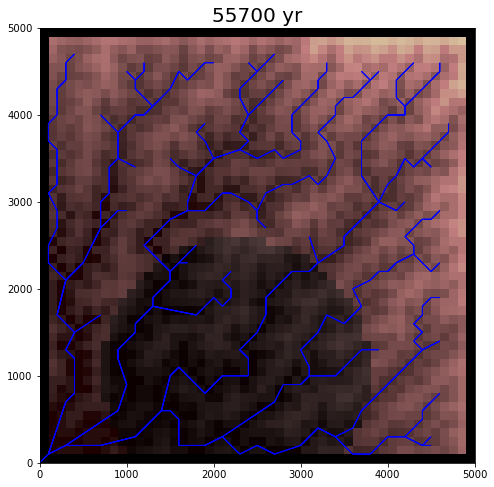

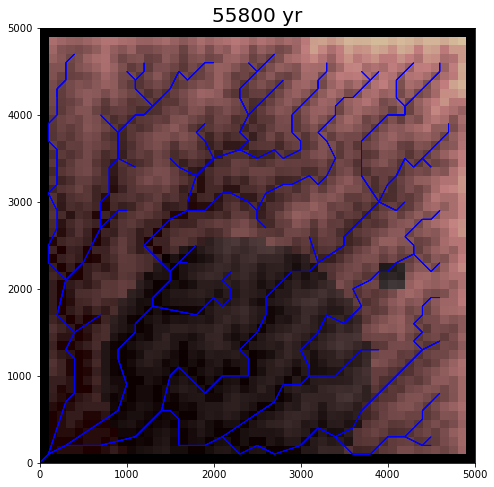

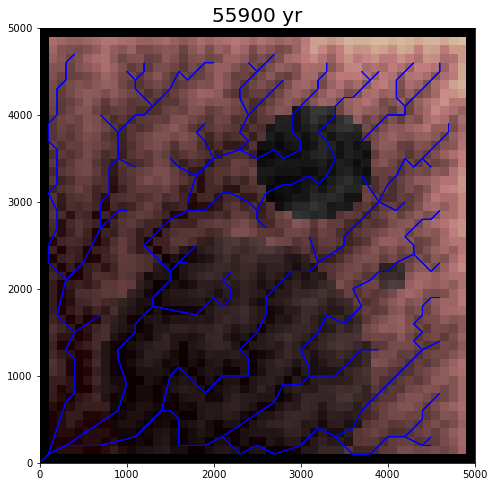

...

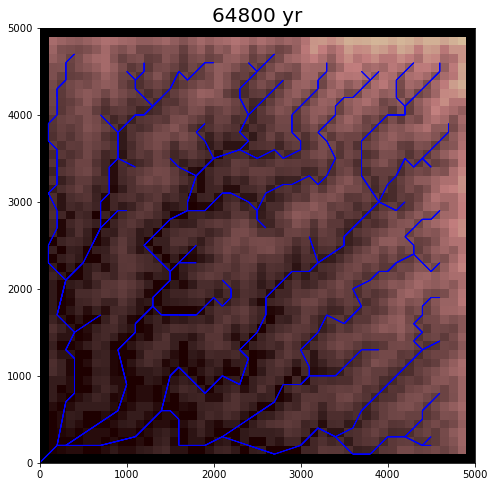

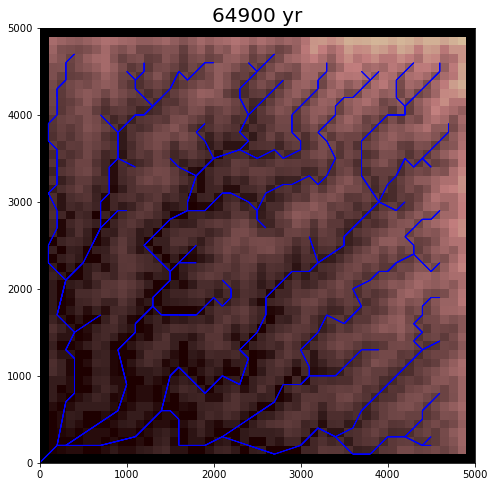

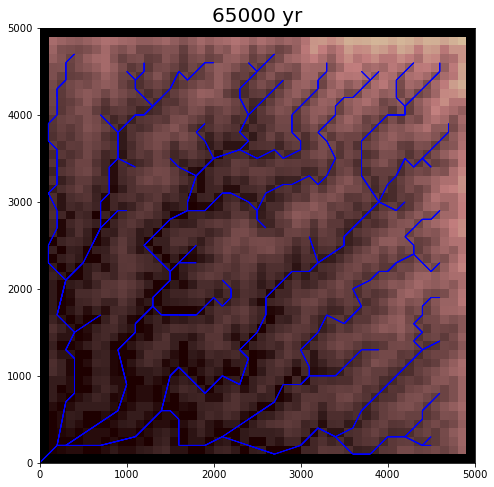

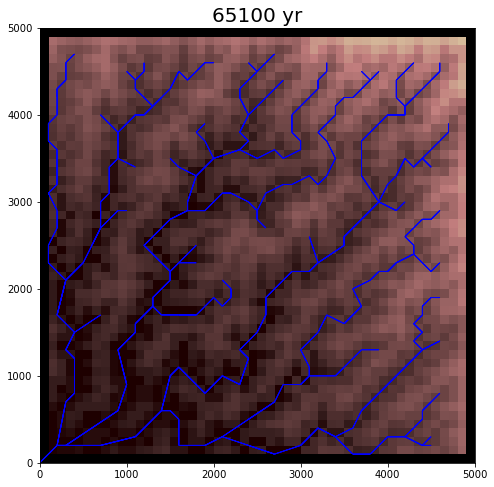

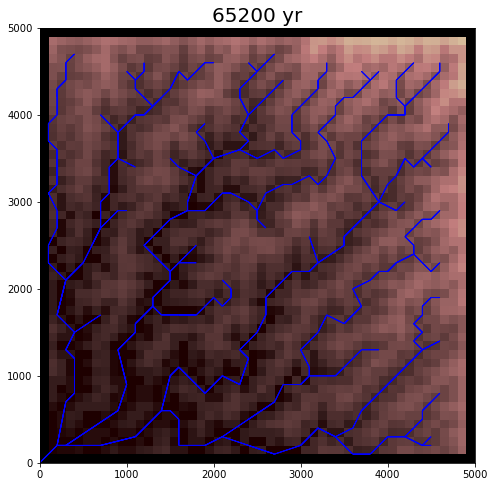

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


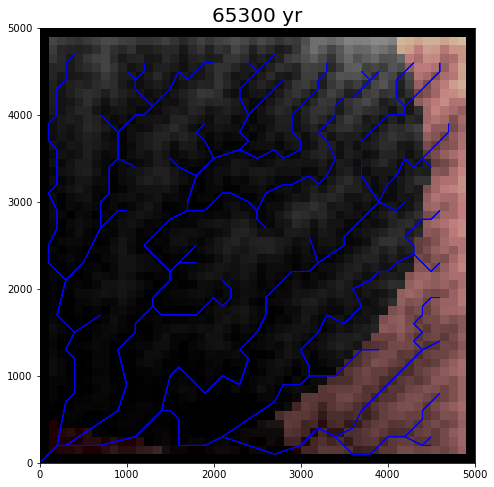

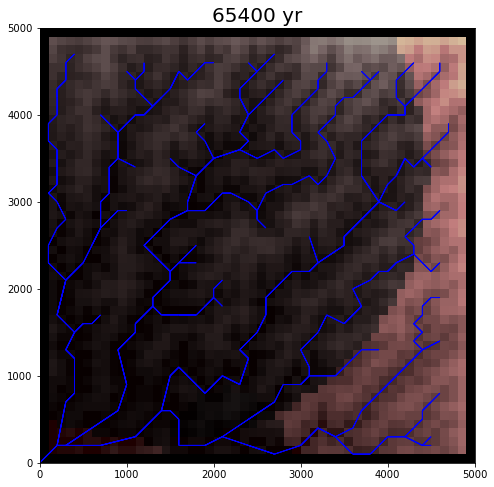

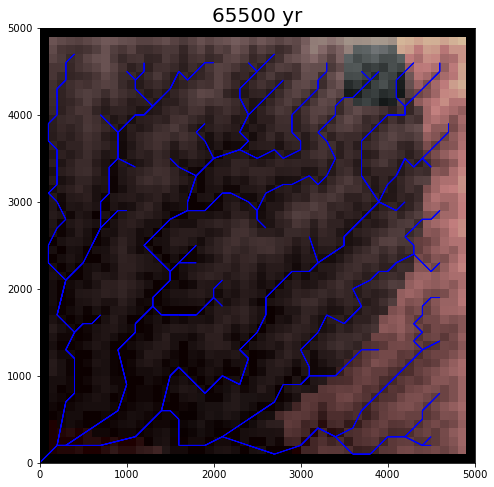

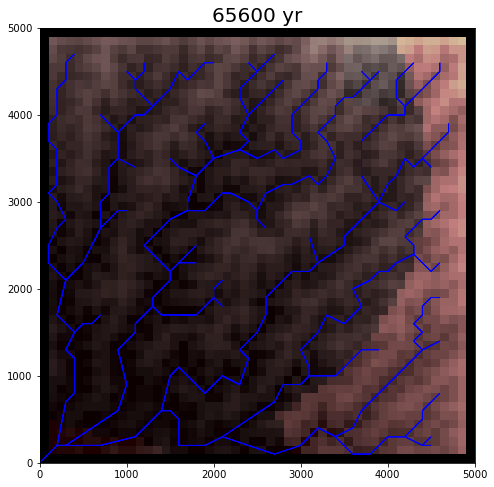

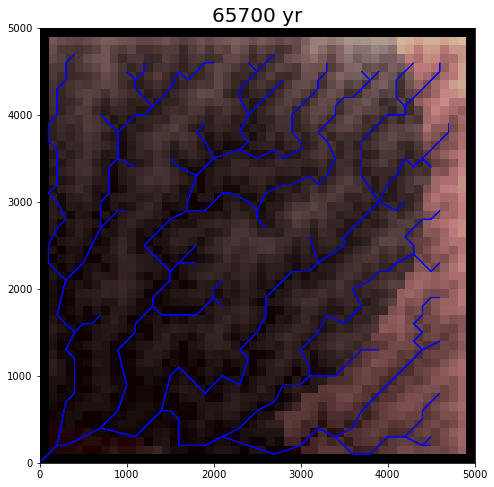

...

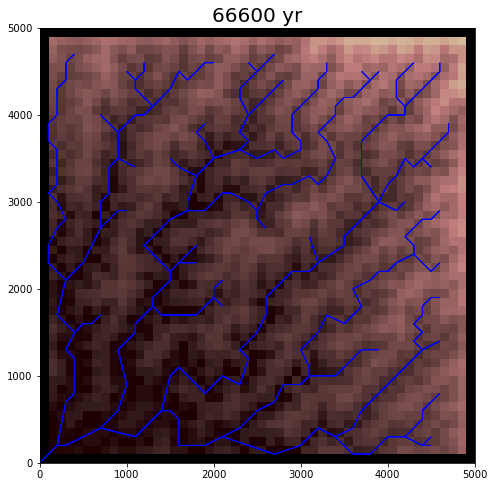

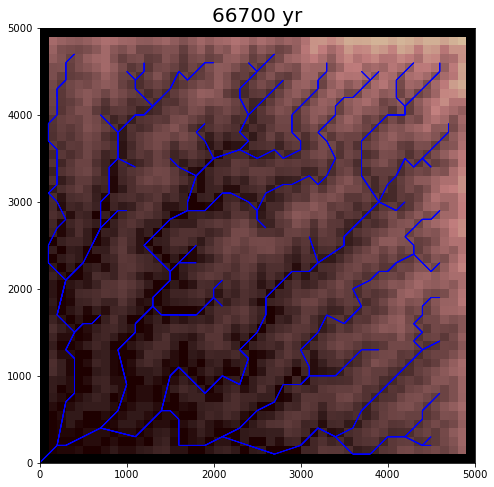

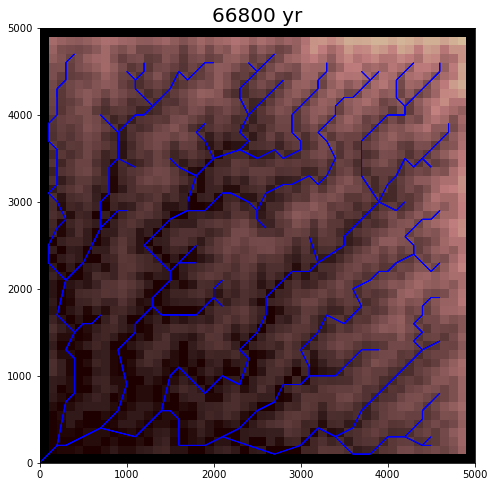

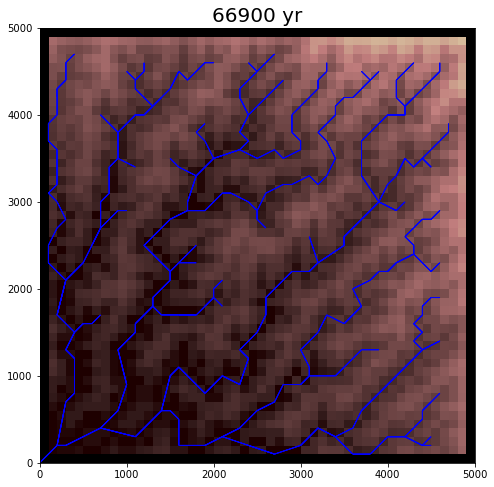

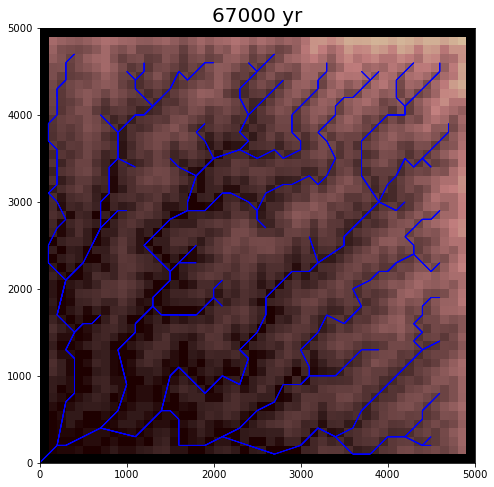

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


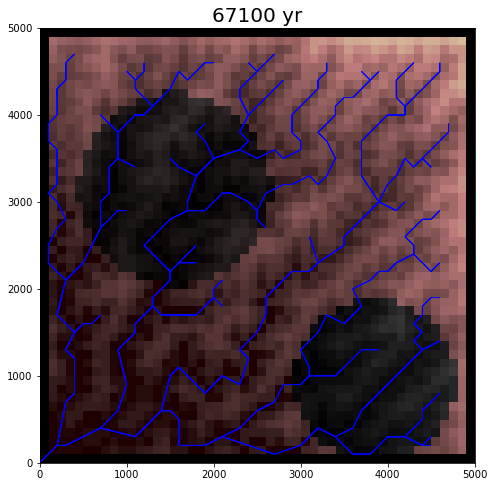

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


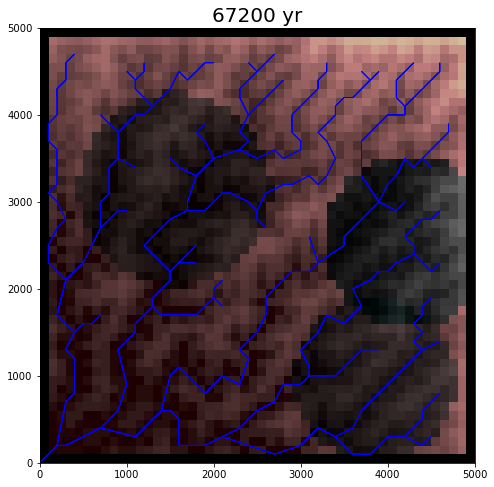

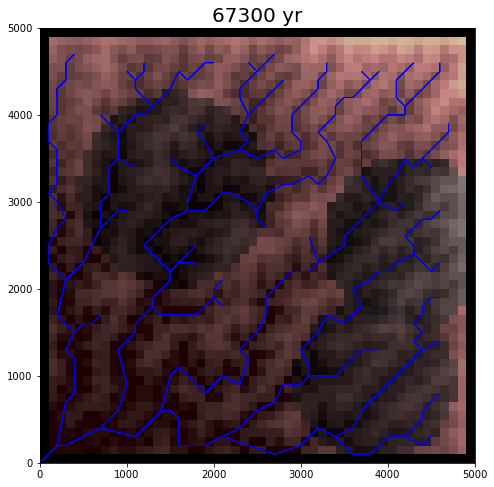

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


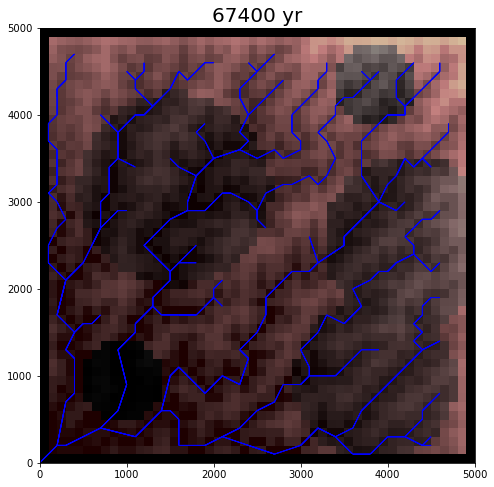

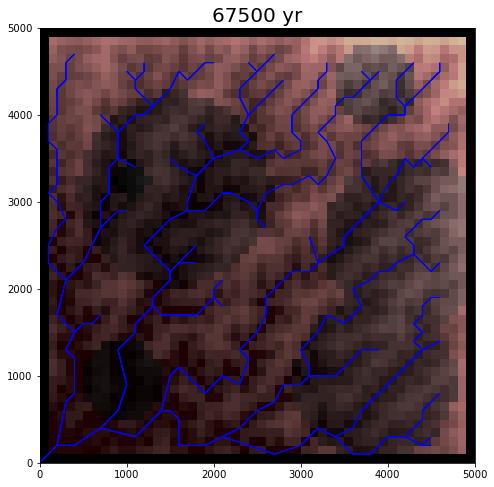

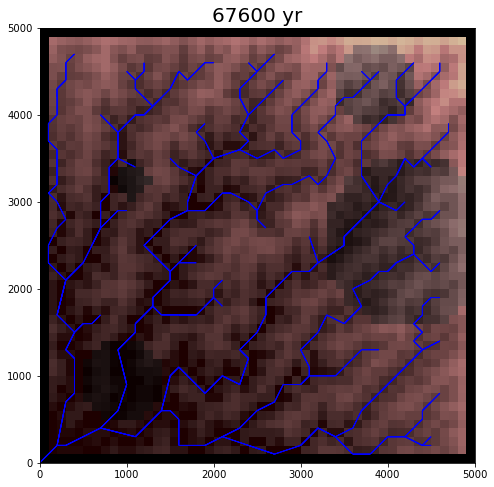

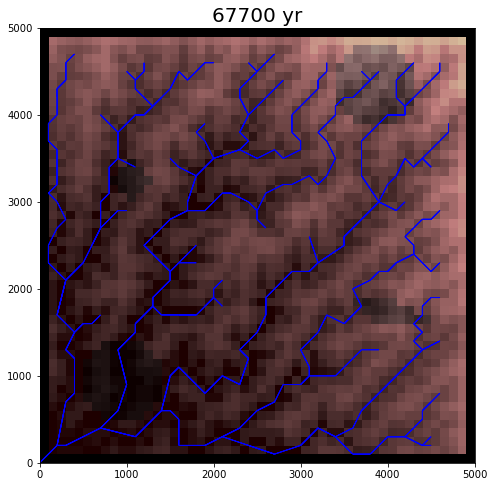

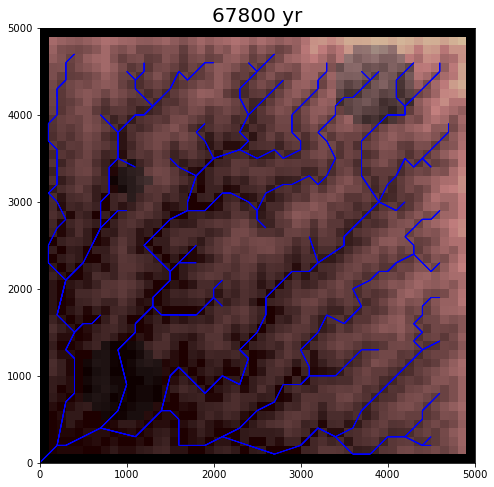

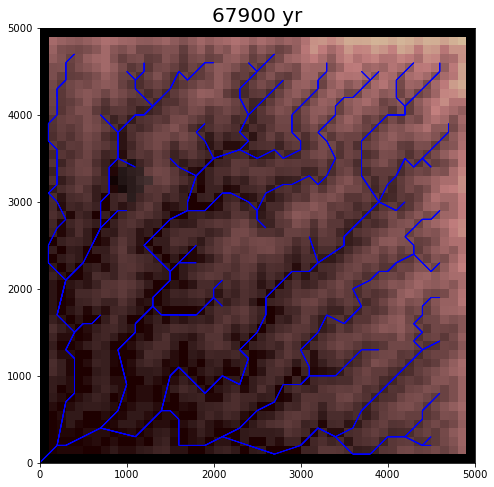

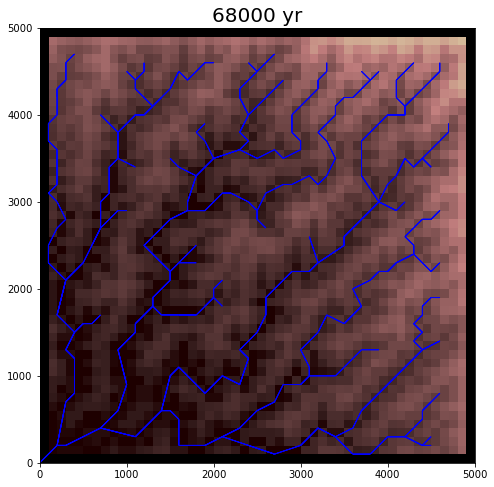

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


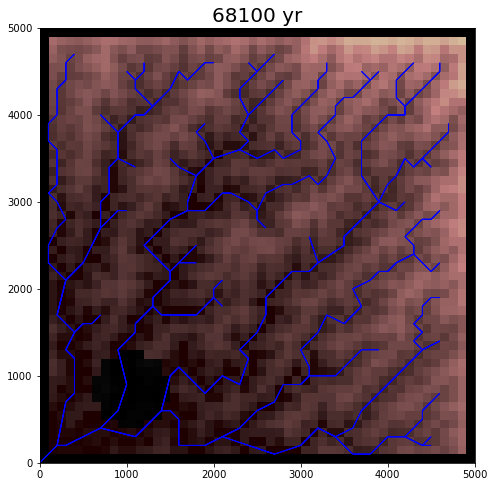

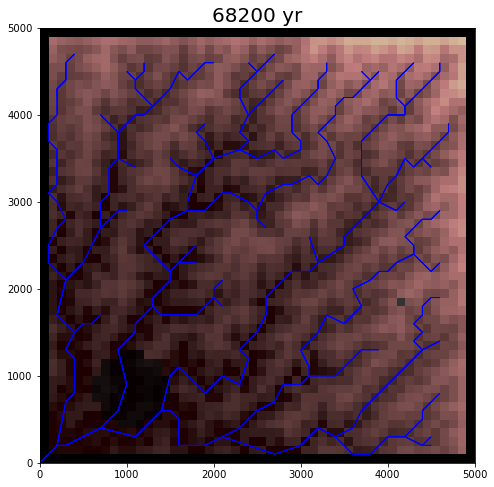

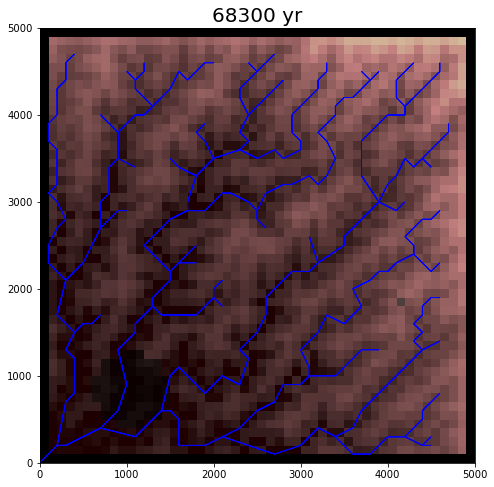

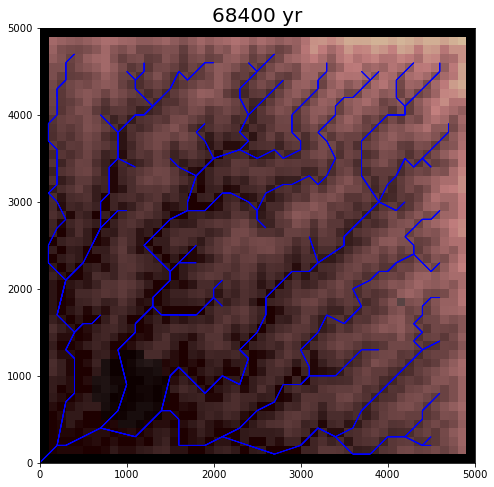

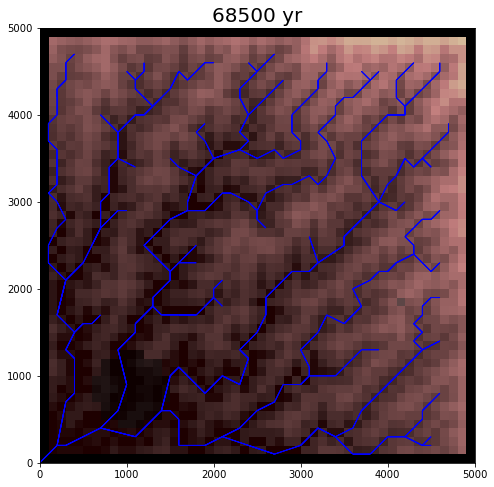

...

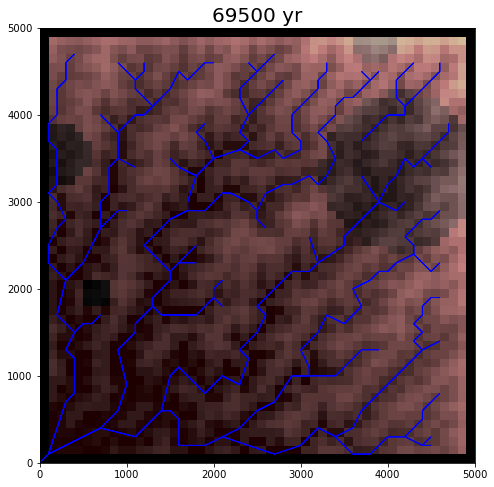

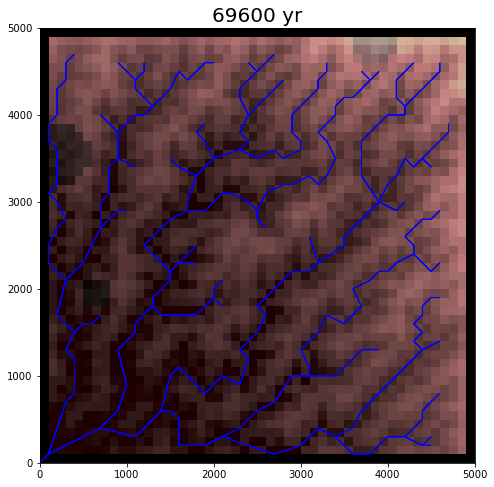

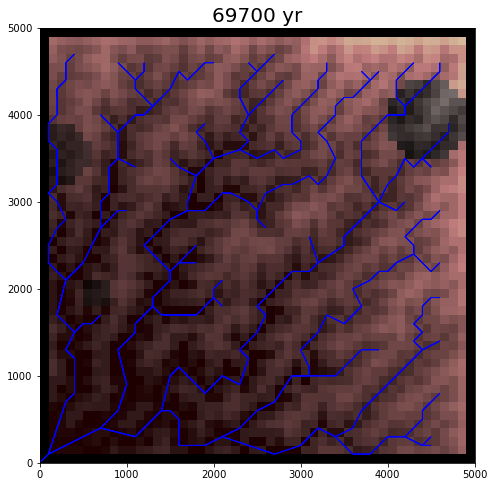

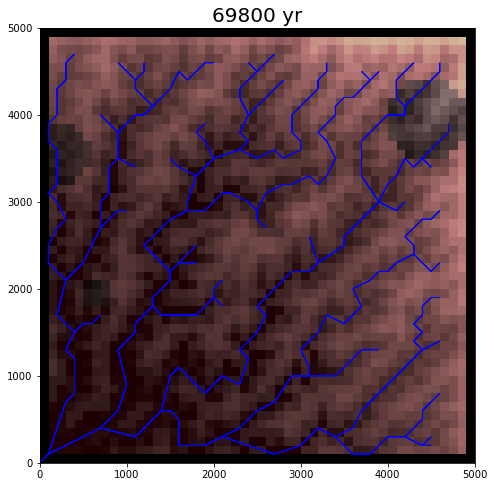

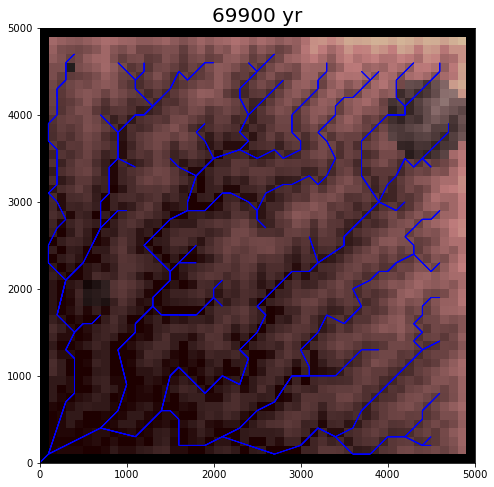

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


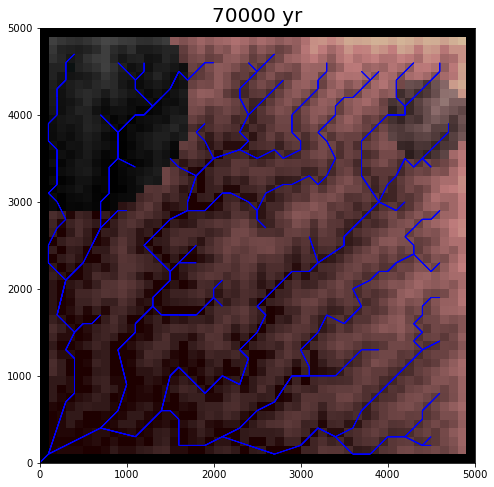

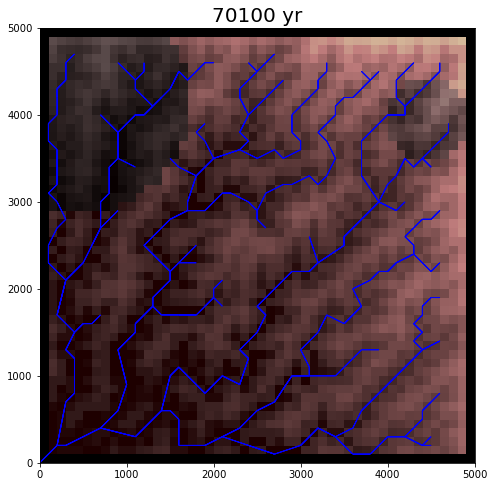

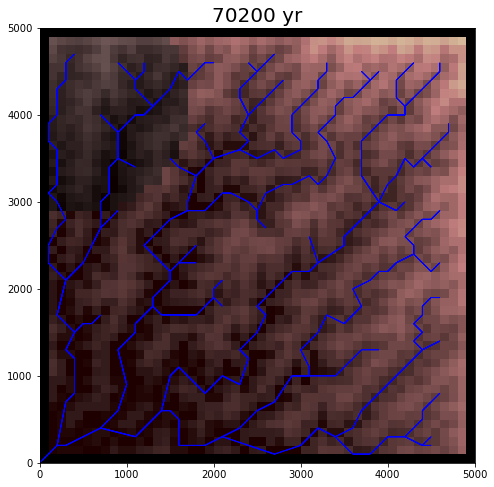

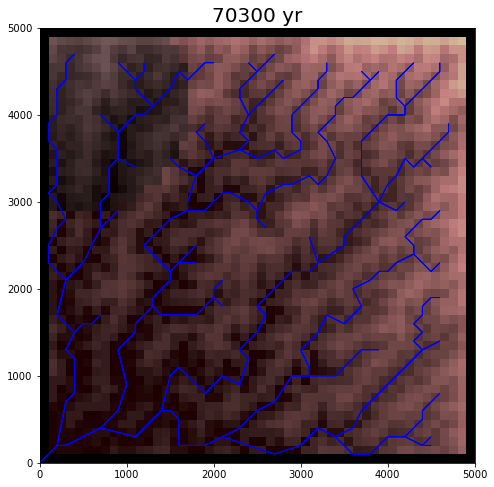

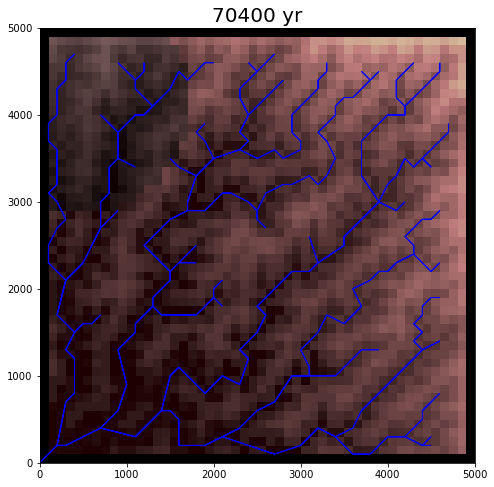

...

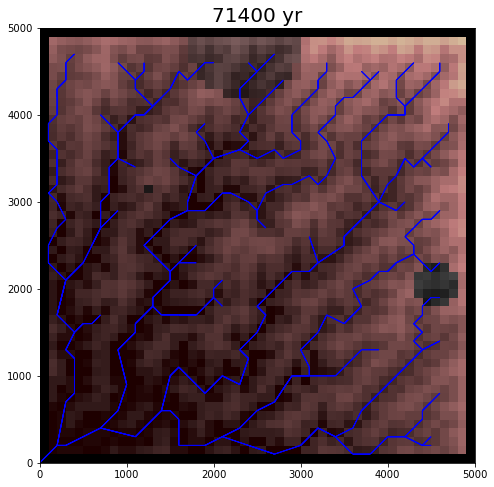

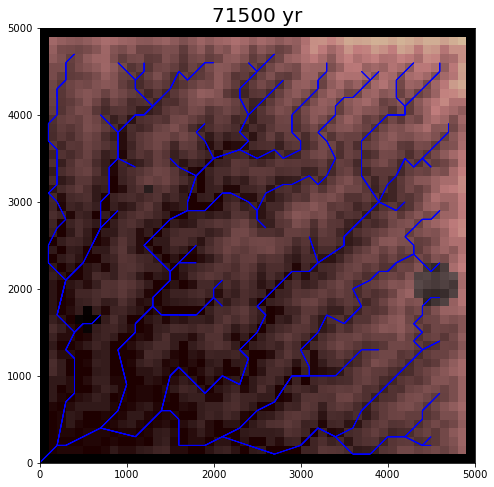

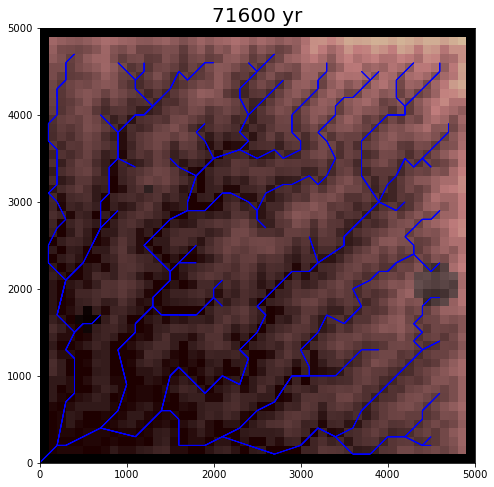

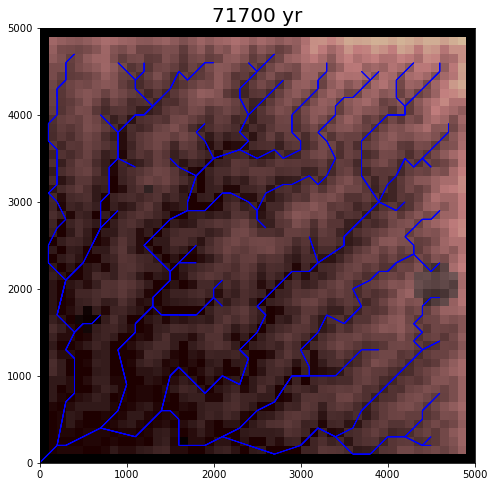

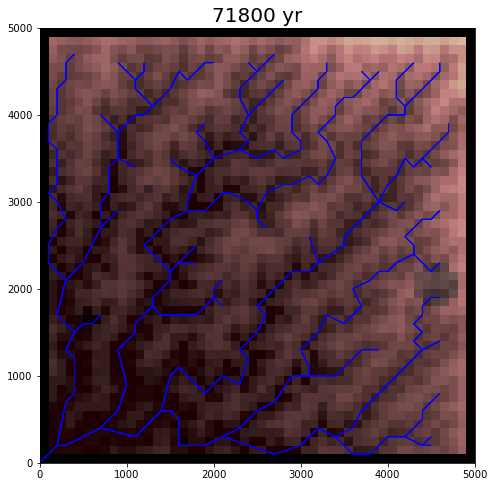

KeyboardInterrupt: 

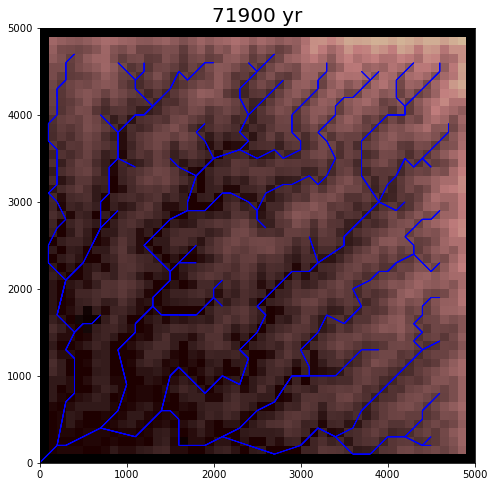

In [40]:
base = './simul/'
save = './imgs/'
files = sorted(os.listdir(base))
ks_files = [f for f in files if f[-3:] == 'npy']
mg_files = [f for f in files if f[-2:] == 'nc']
for f1,f2 in zip(ks_files,mg_files):
    f1p=base+f1
    f2=base+f2
    K_sed = np.load(f1p)
    mg = read_netcdf(f2)
    
    nmg = create_network_from_raster(
                                    mg,
                                    method='variable',
                                    n_widths=dx,
                                    min_channel_thresh=30000,
                                    fields=['drainage_area', 'topographic__elevation']
                                    )
    plotter(mg,K_sed)
    fig = plt.gcf()
    fig.set_size_inches(8,8)
    savename = save + f1[:-3]+'png'
    fig.patch.set_facecolor('white')
    # add in timestamp
    #plt.text(,,'t = {}'.format(round()))
##################################### add in the text with the time
    t = int(f1.split('.')[0].split('_')[1])*dt
    plt.title('{} yr'.format(t),fontsize=20)
    plt.savefig(savename, dpi=100)
    plt.show()
    

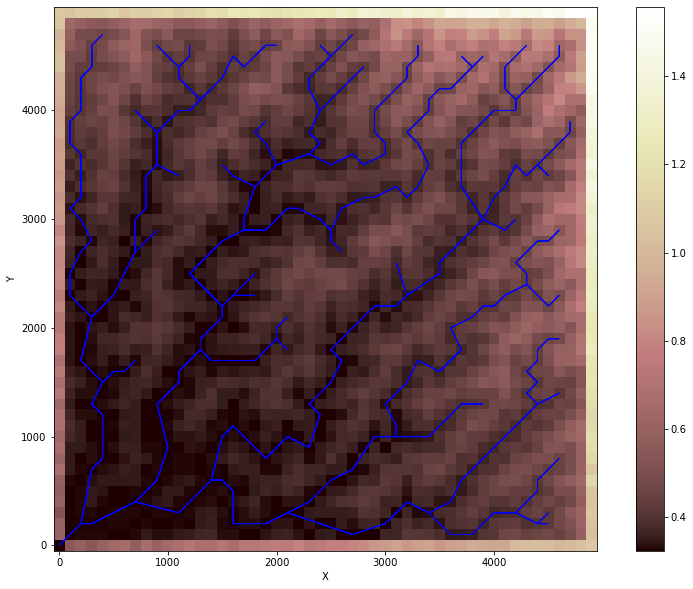

In [41]:
# Map of topographic elevation and the fluvial network
mg.imshow('node','topographic__elevation')
graph.plot_links(nmg,with_id=False)
fig = plt.gcf()
fig.set_size_inches(14, 10)
plt.show()

### Plot a timeseries of sediment flux at the watershed outlet

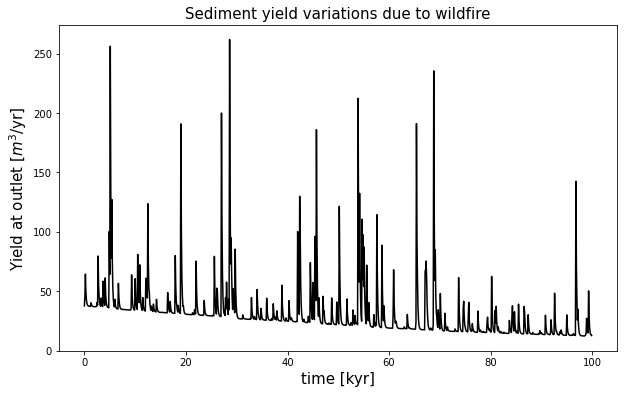

In [42]:
# Sediment flux plot
base = './simul/'
save = './imgs/'
files = sorted(os.listdir(base))
mg_files = [f for f in files if f[-2:] == 'nc']
fluxSeries = []
T = []
for f in mg_files:
    mg = read_netcdf(base+f)
    t = int(f.split('.')[0].split('_')[1])*dt
    flux = mg.at_node['sediment__flux']
    fluxSeries.append(flux.max())
    T.append(t)
T = np.array(T)

plt.plot(T/1000,fluxSeries,color='black')
plt.xlabel('time [kyr]',fontsize=15)
plt.ylabel('Yield at outlet [$m^3$/yr]',fontsize=15)
plt.title('Sediment yield variations due to wildfire', fontsize=15)
fig = plt.gcf()
fig.set_size_inches(10,6)
fig.patch.set_facecolor('white')

#plt.savefig('fireFlux.png')

### Make a gif to show the landscape over time

In [45]:
# Make gif
save = './imgs/'
files = sorted(os.listdir(save))

with imageio.get_writer('movie_new.mp4', mode='I',fps=12) as writer:
    for f in files:
        #print(f)
        im = imageio.imread(save+f)
        writer.append_data(im)

ImportError: To use the imageio ffmpeg plugin you need to 'pip install imageio-ffmpeg'

## Calculate a channel profile

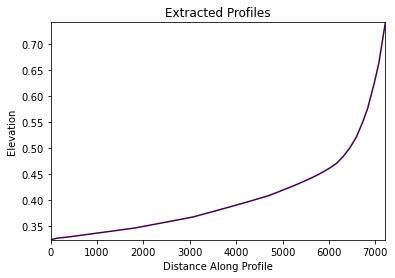

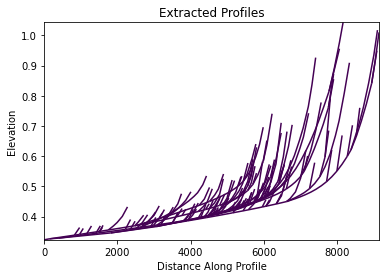

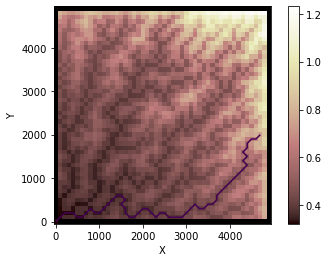

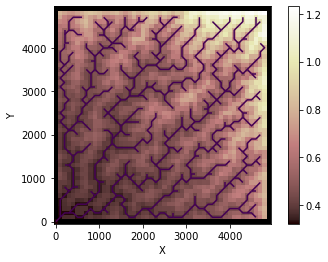

In [62]:
# Instantiate main channel profiler
prf_main = ChannelProfiler(mgfs,
                           main_channel_only=True,
                           minimum_channel_threshold=3e4)# Instantiate multiple channel profiler
prf_multi = ChannelProfiler(mgfs,
                            main_channel_only=False,
                            minimum_channel_threshold=3e4)# Run channel profilers
prf_main.run_one_step()
prf_multi.run_one_step()# Plot channel profiles
prf_main.plot_profiles(ylabel="Elevation")
plt.savefig('profile1.png',dpi=300)
plt.show()
prf_multi.plot_profiles(ylabel="Elevation")
plt.savefig('profile2.png',dpi=300)
plt.show()
prf_main.plot_profiles_in_map_view()
plt.show()
prf_multi.plot_profiles_in_map_view()
plt.show()

## Results

In [63]:
from IPython.display import Video

Video("movie.mp4")

## Conclusions

#### 1. Fire impacts the sediment flux over time

#### 2. We can model it with SPACE

## Next Steps:

#### 1. Calibrate & simulate

#### 2. Bigger landscapes / smaller timesteps

#### 3. Comparision of fire / no fire for sediment transport and landscape evolution

# THANK YOU
We can't thank Irina, Nicole, Mark, and Benjamin enough for ESPIn

& Thanks also Shelby & Brooke for the help : )